<a href="https://colab.research.google.com/github/p25-c4/car/blob/main/0310_final_car_project_sg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import pandas as pd

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

from sklearn.tree import export_graphviz
import graphviz

from scipy import stats
from scipy.stats import ttest_ind

import statsmodels.formula.api as smf
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.api import qqplot, add_constant


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%load_ext google.colab.data_table

# Load the Data

In [4]:
# df = pd.read_csv("data/data2/Car.csv")
# df.head()

In [5]:
## 단위 제거
# df['Engine'] = pd.to_numeric(df['Engine'].replace(' CC', "", regex=True),errors = 'coerce')
# df['Mileage'] = pd.to_numeric(df['Mileage'].replace(' kmpl', "", regex=True),errors = 'coerce')
# df['Power'] = pd.to_numeric(df['Power'].replace(' bhp', "", regex=True),errors = 'coerce')

## Name에서 Brand 추출
# df['Brand'] = df['Name'].str.split().str[0]

# df.head()

In [6]:
# df.to_csv("car_used.csv", index=False)

In [7]:
df = pd.read_csv("/content/drive/MyDrive/PABA/data_file/car_used.csv")
df.head()
df.shape

(7253, 14)

In [8]:
df['Mileage'].max()

33.54

# EDA & Preprocessing

- 데이터 전처리 항목
    1. Owner_Type: 숫자형으로 변환, 4 이상은 4로 처리
        - 4 이상인 자료가 12개 밖에 되지 않아 4로 처리
   
    2. Name -> Brand: 국가(대륙) 별로 feature 추가
        - Brand별 가격 차이가 있을 것으로 생각해 Brand feature 추가
        - 비슷한 국가, 대륙의 Brand 가격이 비슷할 것으로 생각하여 국가(대륙)별로 묶으려 하였으나, 데이터를 살펴본 결과 그렇지 않아서 그룹화 기준 변경
        - Brand에 따른 가격의 median을 내림차순 정렬하여 적절한 선에서 4가지 그룹으로 파생변수 Brand_level 생성
   
    3. Location: 지역별 가격 차이가 있어 보여서, dummy변수 처리 후 모델평가 과정에서 제외 여부 결정.
   
    4. Year --> 연식(age)
        - Year 별 Price 산점도를 확인한 결과, 오래된 차 일수록 가격이 낮은 경향이 있음.
        - Price가 비슷한 시기에 측정된 것으로 추측됨.
        - 따라서 회귀분석에 적절한 'age' feature를 추가함.
    
    5. Fuel_Type

    6. Transmission
    
    7. Kilometer
        - 주행거리 650만 km인 outlier 하나 제거
        - right-skewed 함. 표준화 회귀계수 구할 때 scailing 필요

    8. Mileage
        - 0으로 되어있는 결측치
        - Mileage와 Engine 상관계수(0인 값이 있음에도) 0.59로 높음
        - 휘발유와 경유로 나누어서 Mileage ~ Engine 선형회귀 적용

    9. Engine
        - 46개 결측치 --> 직접 차량 찾아서 채워 넣음
        - 동시에 Power도 결측치인 값 직접 찾아서 채워 넣음

    10. Power
        - Engine과 상관관계 0.86
        - Power ~ Engine 선형회귀를 통해 결측치 대체

    11. Seats
        - 결측치 직접 찾아서 대체

    12. Owner_Type_Id
    
    13. Age

    14. 결측치 -->
        5-1. New_Price column 제거
        결측치가 너무 많아서(약 90%가 결측치)
    
    15. 이상치 --> Price로 찾아서 개별적 제거여부 결정

## 결측치 확인

In [9]:
df.isnull().sum()

Name                    0
Location                0
Price                1053
Year                    0
Kilometers_Driven       0
Fuel_Type               0
Transmission            0
Owner_Type              0
Mileage                 2
Engine                 46
Power                 175
Seats                  53
New_Price            6247
Brand                   0
dtype: int64

## 명목형 변수

### Owner_Type

In [10]:
# Fourth & Above인 rows
df[df['Owner_Type']=='Fourth & Above']

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Brand
29,Toyota Innova 2.5 V Diesel 7-seater,Mumbai,6131.84,2007,262000,Diesel,Manual,Fourth & Above,12.8,2494.0,102.00,7.0,NaN,Toyota
885,Maruti Grand Vitara AT,Chennai,8431.28,2008,77000,Petrol,Automatic,Fourth & Above,9.7,1995.0,163.50,5.0,NaN,Maruti
1081,Hyundai i20 1.2 Sportz Option,Bangalore,4982.12,2010,61000,Petrol,Manual,Fourth & Above,17.0,1197.0,80.00,5.0,NaN,Hyundai
1699,Ford Endeavour 4x2 XLT Limited Edition,Pune,4598.88,2007,90000,Diesel,Manual,Fourth & Above,10.9,2499.0,143.00,7.0,NaN,Ford
2988,Toyota Innova 2.5 G4 Diesel 8-seater,Chennai,7818.10,2005,240000,Diesel,Manual,Fourth & Above,12.8,2494.0,102.00,8.0,NaN,Toyota
3368,Maruti Swift Ldi BSIII,Pune,3295.86,2009,80000,Diesel,Manual,Fourth & Above,17.8,1248.0,75.00,5.0,NaN,Maruti
3404,Maruti Swift 1.3 VXi,Jaipur,3602.46,2006,125000,Petrol,Manual,Fourth & Above,16.1,NaN,NaN,NaN,NaN,Maruti
4148,Ford Ikon 1.3 Flair,Coimbatore,3019.93,2008,59833,Petrol,Manual,Fourth & Above,13.8,1299.0,70.00,5.0,NaN,Ford
5647,Toyota Qualis Fleet A3,Mumbai,3372.51,2001,227000,Diesel,Manual,Fourth & Above,0.0,2446.0,NaN,8.0,NaN,Toyota
6226,Maruti Omni E 8 Str STD,Bangalore,NaN,2005,81245,Petrol,Manual,Fourth & Above,16.8,796.0,34.20,8.0,NaN,Maruti


In [11]:
# Owner_Type 숫자형으로 변환
df.loc[df["Owner_Type"]=="First", "Owner_Type_id"] = 1
df.loc[df["Owner_Type"]=="Second", "Owner_Type_id"] = 2
df.loc[df["Owner_Type"]=="Third", "Owner_Type_id"] = 3
df.loc[df["Owner_Type"]=="Fourth & Above", "Owner_Type_id"] = 4
df.head()

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Brand,Owner_Type_id
0,Maruti Wagon R LXI CNG,Mumbai,2682.68,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,NaN,Maruti,1.0
1,Hyundai Creta 1.6 CRDi SX Option,Pune,19162.00,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,NaN,Hyundai,1.0
2,Honda Jazz V,Chennai,6898.32,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,8.61 Lakh,Honda,1.0
3,Maruti Ertiga VDI,Chennai,9197.76,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,NaN,Maruti,1.0
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,27194.71,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,NaN,Audi,2.0


- 4 이상인 데이터가 12개 존재 -> 데이터 개수가 적어 모두 4로 대체
- 모두 숫자형 변수로 치환해 데이터 처리 사용

### Brand

In [12]:
# Brand_Country feature 추가
india_car = ["Ambassador", "Force", "Hindustan", "Mahindra", "Maruti", "Tata"]
eu_car = ["Audi", "BMW", "Bentley", "Fiat", "Jaguar", "Lamborghini", "Land", "Mercedes-Benz",
          "Mini", "OpelCorsa", "Porsche", "Renault", "Skoda", 'Smart', 'Volkswagen','Volvo' ]
us_car = ['Chevrolet', 'Ford', 'Jeep']
jp_car = ["Datsun", "Honda","ISUZU", "Mitsubishi","Nissan","Toyota"]
kr_car = ['Hyundai']

df.loc[df["Brand"].isin(india_car),"Brand_Country"] = "India"
df.loc[df["Brand"].isin(eu_car),"Brand_Country"] = "Europe"
df.loc[df["Brand"].isin(us_car),"Brand_Country"] = "US"
df.loc[df["Brand"].isin(jp_car),"Brand_Country"] = "Japan"
df.loc[df["Brand"].isin(kr_car),"Brand_Country"] = "Korea"

In [13]:
# Brand_level feature 추가
brand_h = ['Lamborghini', 'Porsche', 'Land', 'Jaguar', 'Bentley', 'Mini',
       'Mercedes-Benz', 'Audi', 'BMW']
brand_mh = ['Jeep', 'Volvo', 'ISUZU', 'Mitsubishi',
       'Toyota', 'Force', 'Mahindra', 'Skoda']
brand_ml = ['Ford', 'Renault', 'Honda',
       'Volkswagen', 'Hyundai', 'Nissan', 'Maruti']
brand_l = ['Datsun', 'Smart', 'Tata',
       'Fiat', 'Chevrolet', 'Ambassador', 'Hindustan', 'OpelCorsa']

df.loc[df["Brand"].isin(brand_h),"Brand_level"] = "high"
df.loc[df["Brand"].isin(brand_mh),"Brand_level"] = "middle_high"
df.loc[df["Brand"].isin(brand_ml),"Brand_level"] = "middle_low"
df.loc[df["Brand"].isin(brand_l),"Brand_level"] = "low"

In [14]:
df.head()

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Brand,Owner_Type_id,Brand_Country,Brand_level
0,Maruti Wagon R LXI CNG,Mumbai,2682.68,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,NaN,Maruti,1.0,India,middle_low
1,Hyundai Creta 1.6 CRDi SX Option,Pune,19162.00,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,NaN,Hyundai,1.0,Korea,middle_low
2,Honda Jazz V,Chennai,6898.32,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,8.61 Lakh,Honda,1.0,Japan,middle_low
3,Maruti Ertiga VDI,Chennai,9197.76,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,NaN,Maruti,1.0,India,middle_low
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,27194.71,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,NaN,Audi,2.0,Europe,high


- 브랜드를 국가, 대륙별로 나눠 가격 파악
- 브랜드와 국가 위치의 상관성이 낮아 브랜드 별 가격으로 그룹화 진행

In [15]:
3# 브랜드 별 가격
df.groupby(["Brand"])["Price"].describe().sort_values(by="50%", ascending=False)

,count,mean,std,min,25%,50%,75%,max
Brand,,,,,,,,
Lamborghini,1.0,183955.200000,NaN,183955.20,183955.2000,183955.200,183955.2000,183955.20
Porsche,18.0,74116.061111,30096.092377,3096.58,62433.6275,72079.780,96940.5575,114972.00
Land,60.0,60183.243000,37014.510316,16862.56,33000.7975,53653.600,72608.6475,245273.60
Jaguar,43.0,59961.551628,28201.301675,24527.36,40830.3900,50281.090,73321.4750,153296.00
Bentley,2.0,48096.620000,59889.144224,5748.60,26922.6100,48096.620,69270.6300,90444.64
Mini,29.0,43103.134828,10758.015072,26060.32,33725.1200,38324.000,53653.6000,68354.69
Mercedes-Benz,325.0,42135.740369,25972.143599,1624.94,22227.9200,37557.520,55186.5600,141047.65
Audi,241.0,40017.252863,19747.788417,11497.20,26826.8000,36407.800,49851.8600,111814.10
BMW,273.0,39660.763590,24476.634075,2422.08,21384.7900,32698.040,50587.6800,143592.36


In [16]:
# 브랜드 별 가격
import plotly.express as px
fig = px.scatter(df,x='Brand',y='Price')
fig.show()

- Brand 별로 가격 차이가 있는 것 확인
- Brand 개수가 32개로 많아서 그룹화
- Brand별 Price 중위값을 기준으로 4개 그룹으로 나눔

### Location

<ipython-input-17-28b578d329f4>:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




<Axes: xlabel='Location', ylabel='Price'>

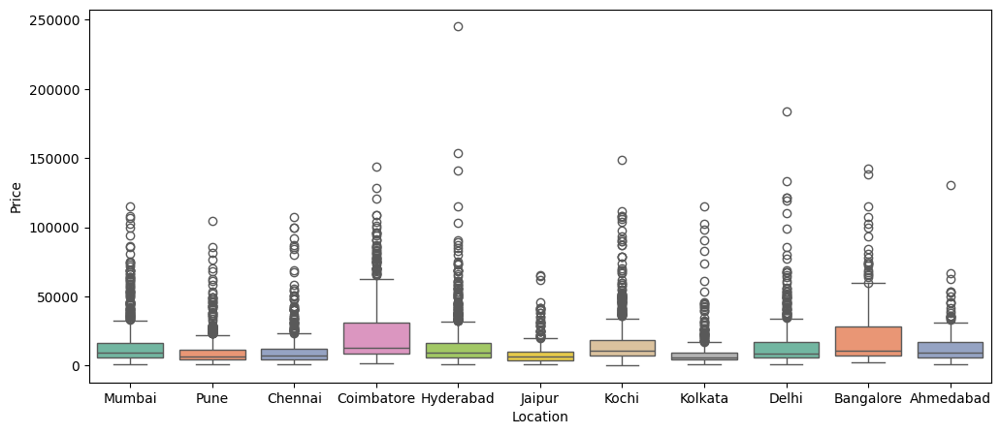

In [17]:
# Location별 Price
fig, axes = plt.subplots(figsize=(12,5))
sns.boxplot(data = df, y="Price", x="Location", palette="Set2")

In [18]:
#
pivot_table = df.pivot_table(index='Location', columns='Brand_level', values="Price", aggfunc='count')

pivot_table['high_ratio'] = (pivot_table['high'] / pivot_table.sum(axis=1)).round(3)
pivot_table['low_ratio'] = (pivot_table['low'] / pivot_table.sum(axis=1)).round(3)
pivot_table['middlehigh_ratio'] = (pivot_table['middle_high'] / pivot_table.sum(axis=1)).round(3)
pivot_table['middlelow_ratio'] = (pivot_table['middle_low'] / pivot_table.sum(axis=1)).round(3)

pivot_table

Brand_level,high,low,middle_high,middle_low,high_ratio,low_ratio,middlehigh_ratio,middlelow_ratio
Location,,,,,,,,
Ahmedabad,35,11,39,148,0.150,0.047,0.167,0.634
Bangalore,100,18,55,192,0.274,0.049,0.151,0.525
Chennai,62,39,83,322,0.123,0.077,0.164,0.636
Coimbatore,161,38,104,361,0.242,0.057,0.157,0.543
Delhi,103,11,127,331,0.180,0.019,0.222,0.578
Hyderabad,117,42,127,473,0.154,0.055,0.167,0.623
Jaipur,23,39,52,310,0.054,0.092,0.123,0.731
Kochi,115,32,90,439,0.170,0.047,0.133,0.649
Kolkata,52,46,62,392,0.094,0.083,0.112,0.710


- location별 가격에 따라 차량 수의 편차가 큼
- 모델링 과정에서 변수 선택 여부 결정

### Fuel_Type

<Axes: xlabel='Fuel_Type', ylabel='Price'>

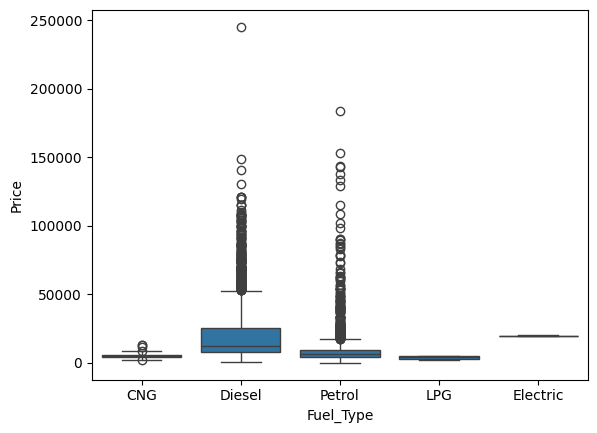

In [19]:
sns.boxplot(data=df,x='Fuel_Type',y='Price')

In [20]:
fuel_type_median = df.pivot_table(index='Fuel_Type', values="Price", aggfunc='median')
print(fuel_type_median)

               Price
Fuel_Type           
CNG         4982.120
Diesel     12187.030
Electric   19736.860
LPG         3985.700
Petrol      6492.085


- 전기차를 제외한 나머지 차들은 중간값이 큰 차이가 나타나지 않음
- 전기차와 나머지 차들의 차이나는 수준을 검정하기 위해 ANOVA 검정 진행

**ANOVA**

Ho = fuel_type별로 평균이 같음  
H1 = 평균의 수준의 차이가 있는 수준이 적어도 하나 존재

In [21]:
# 각각의 fuel type 별로 price가 포함된 데이터프레임 생성
price_by_fuel_type = df.groupby('Fuel_Type')['Price'].apply(lambda x: pd.Series(x.values)).unstack()

# 결과 출력
print(price_by_fuel_type)

               0         1         2         3         4        5        6     \
Fuel_Type                                                                       
CNG         2682.68   4982.12   2146.14   7204.91   3219.22  2912.62  3065.92   
Diesel     19162.00   9197.76  27194.71   5365.36  26826.80  7971.39  2989.27   
Electric   19928.48  19545.24       NaN       NaN       NaN      NaN      NaN   
LPG         3602.46   4368.94   2222.79   2529.38   4752.18  4368.94  4905.47   
Petrol      6898.32  15252.95   6882.99  36024.56   2866.64  4368.94  6515.08   

              7         8         9     ...  3842      3843  3844  3845  3846  \
Fuel_Type                               ...                                     
CNG        5595.30   5365.36   6898.32  ...   NaN       NaN   NaN   NaN   NaN   
Diesel     8584.58  41389.92  26826.80  ...   NaN  16203.39   NaN   NaN   NaN   
Electric       NaN       NaN       NaN  ...   NaN       NaN   NaN   NaN   NaN   
LPG        2989.27   4905.4

In [22]:
df_fuelbyprice=price_by_fuel_type.transpose()
df_fuelbyprice

Fuel_Type,CNG,Diesel,Electric,LPG,Petrol
0,2682.68,19162.00,19928.48,3602.46,6898.32
1,4982.12,9197.76,19545.24,4368.94,15252.95
2,2146.14,27194.71,NaN,2222.79,6882.99
3,7204.91,5365.36,NaN,2529.38,36024.56
4,3219.22,26826.80,NaN,4752.18,2866.64
...,...,...,...,...,...
3847,NaN,NaN,NaN,NaN,NaN
3848,NaN,NaN,NaN,NaN,NaN
3849,NaN,NaN,NaN,NaN,NaN
3850,NaN,NaN,NaN,NaN,NaN


<Axes: >

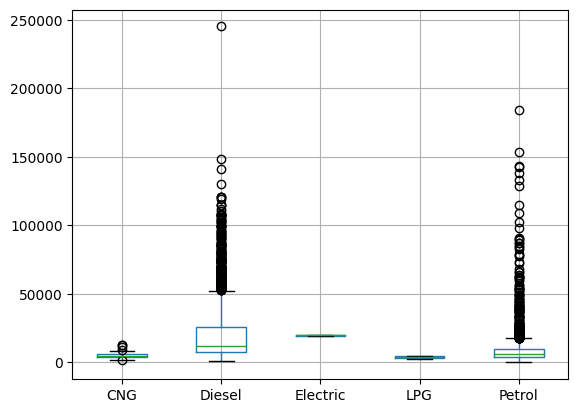

In [23]:
df_fuelbyprice.boxplot()

In [24]:

# 결측값을 포함한 행 삭제
df_fuelbyprice.dropna(inplace=True)

# ANOVA 실행
f_result = stats.f_oneway(df_fuelbyprice['CNG'], df_fuelbyprice['Diesel'], df_fuelbyprice['LPG'],df_fuelbyprice['Electric'],df_fuelbyprice['Petrol'])

# ANOVA의 f값 p값 저장
f, p = f_result.statistic, f_result.pvalue

# ANOVA의 f값, p값 출력
print( "One-way ANOVA ")
print( " F통계량 : {} " .format(f))
print( " p-value : {} " .format(p))

One-way ANOVA 
 F통계량 : 5.3129062796547535 
 p-value : 0.047873280771571575 


- 유의 수준 5%에서 p_value가 0.047로 자동차 간 평균의 차이가 있다고 판단(Ho 기각)
- 전기차와 다른 차의 차이는 유의미하기 때문에 전기차 데이터 정제를 진행하지 않음

### Transmission

<Axes: xlabel='Transmission', ylabel='Price'>

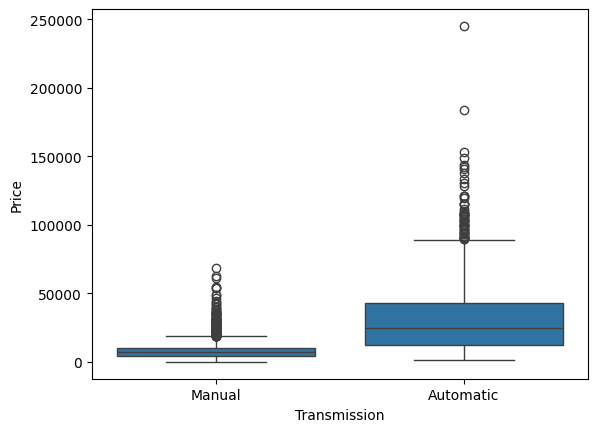

In [25]:
sns.boxplot(data=df,x='Transmission',y='Price')

- Automatic의 가격이 조금 더 높아 보임
- Transmission별 차이를 확인하기 위해 T-test 진행


**T-Test**  
Ho = Transmission별로 평균이 같음  
H1 = Transmission별로 평균이 다름  

In [26]:
# # 각각의 transmission 별로 price가 포함된 데이터프레임 생성
price_by_transmission = df.groupby('Transmission')['Price'].apply(lambda x: pd.Series(x.values)).unstack()

# # 결과 출력
print(price_by_transmission)

                  0        1        2         3         4         5     \
Transmission                                                             
Automatic     27194.71  26826.8  6882.99  41389.92  26826.80  42922.88   
Manual         2682.68  19162.0  6898.32   9197.76   3602.46   5365.36   

                  6         7         8         9     ...  5194  5195  5196  \
Transmission                                          ...                     
Automatic     28436.41  36024.56   4368.94  19162.00  ...   NaN   NaN   NaN   
Manual         7971.39   2989.27  15252.95   8584.58  ...  7.08   NaN   NaN   

              5197  5198  5199  5200  5201  5202  5203  
Transmission                                            
Automatic      NaN   NaN   NaN   NaN   NaN   NaN   NaN  
Manual         NaN   NaN   NaN   NaN   NaN   NaN   NaN  

[2 rows x 5204 columns]


In [27]:
df_pricebytransmission=price_by_transmission.transpose()
df_pricebytransmission

Transmission,Automatic,Manual
0,27194.71,2682.68
1,26826.80,19162.00
2,6882.99,6898.32
3,41389.92,9197.76
4,26826.80,3602.46
...,...,...
5199,NaN,NaN
5200,NaN,NaN
5201,NaN,NaN
5202,NaN,NaN


<Axes: >

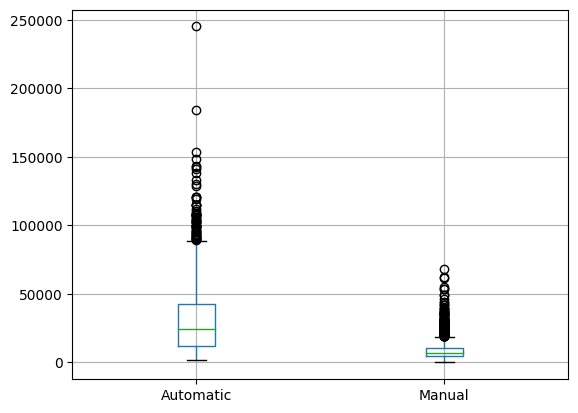

In [28]:
df_pricebytransmission.boxplot()

In [29]:
# 결측값을 포함한 행 삭제
df_pricebytransmission.dropna(inplace=True)

# t-test 수행
t_statistic, p_value = ttest_ind(df_pricebytransmission['Automatic'], df_pricebytransmission['Manual'])

# 결과 출력
print("t-statistic:", t_statistic)
print("p-value:", p_value)


t-statistic: 37.27727951348881
p-value: 3.8461570929531316e-257


- 유의 수준 5%에서 p_value가 1.195로 자동차 간 평균의 차이가 없다고 판단(Ho 참)

## 숫자형 변수

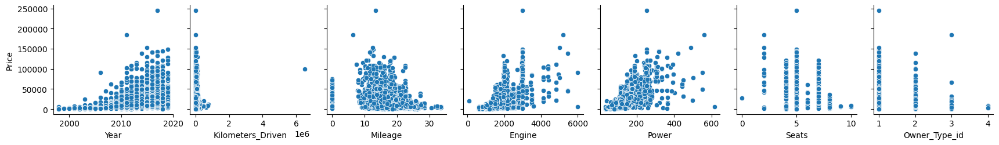

In [30]:
# 수치형 칼럼만 뽑아냄
num_columns = df.select_dtypes(include=['int','float']).columns
# 목적변수와 수치형설명변수간 산점도
selected_df = df[num_columns]
sns.pairplot(selected_df, y_vars='Price', x_vars=num_columns[1:])

<Axes: >

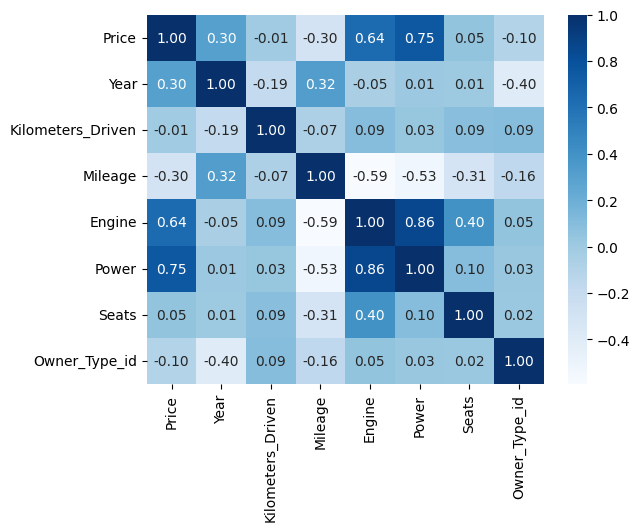

In [31]:
# 목적-설명 상관계수
num_corr = df[num_columns].corr(method='pearson')
# 상관관계 히트맵
sns.heatmap(num_corr,annot=True,fmt='.2f',cmap='Blues')

##Year


<Axes: xlabel='Year', ylabel='Price'>

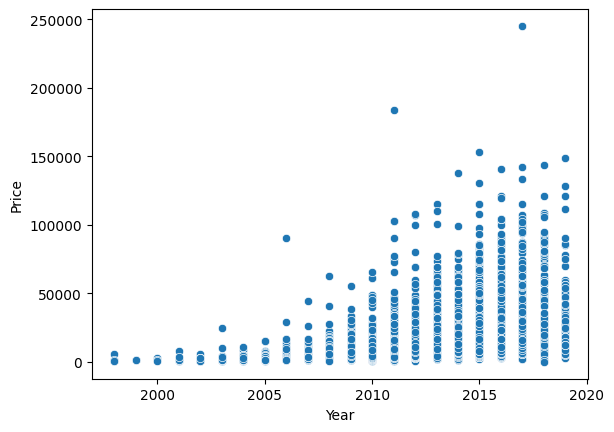

In [32]:
# year, Price scatter plot
sns.scatterplot(data=df, x="Year", y="Price")

- 새 차일수록 가격이 높은 경향이 있음
- Price가 비슷한 시기에 측정된 것으로 추측됨.
- 따라서 회귀분석에 적절한 2020년을 기준으로 자동차의 연식인 'age' feature를 추가함.

In [33]:
# Age 추가
df['Age'] = 2020 - df['Year']
df.head()

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,New_Price,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
0,Maruti Wagon R LXI CNG,Mumbai,2682.68,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,NaN,Maruti,1.0,India,middle_low,10
1,Hyundai Creta 1.6 CRDi SX Option,Pune,19162.00,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,NaN,Hyundai,1.0,Korea,middle_low,5
2,Honda Jazz V,Chennai,6898.32,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,8.61 Lakh,Honda,1.0,Japan,middle_low,9
3,Maruti Ertiga VDI,Chennai,9197.76,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,NaN,Maruti,1.0,India,middle_low,8
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,27194.71,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,NaN,Audi,2.0,Europe,high,7


<Axes: xlabel='Age', ylabel='Price'>

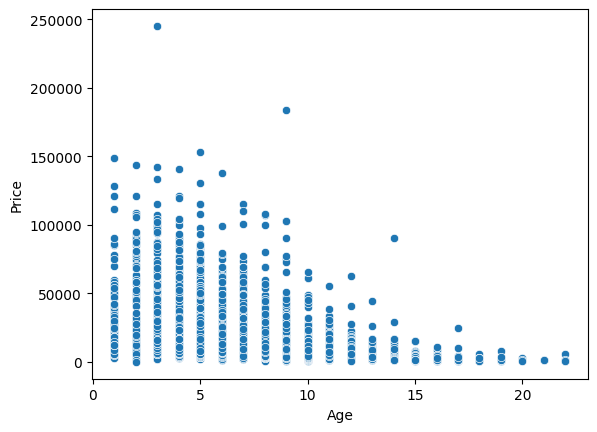

In [34]:
# year, Price scatter plot
sns.scatterplot(data=df, x="Age", y="Price")

### New_Price

In [35]:
# New_price 결측치 비율
print(((df["New_Price"].isnull().sum() / len(df))*100).round(2), "%")

86.13 %


- 결측치 비율이 약 86%로 매우 높아서 변수 자체를 분석에서 제외

In [36]:
# New_Price 제거
df = df.drop(columns = "New_Price")

In [37]:
df.head()

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
0,Maruti Wagon R LXI CNG,Mumbai,2682.68,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,Maruti,1.0,India,middle_low,10
1,Hyundai Creta 1.6 CRDi SX Option,Pune,19162.00,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,Hyundai,1.0,Korea,middle_low,5
2,Honda Jazz V,Chennai,6898.32,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,Honda,1.0,Japan,middle_low,9
3,Maruti Ertiga VDI,Chennai,9197.76,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,Maruti,1.0,India,middle_low,8
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,27194.71,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,Audi,2.0,Europe,high,7


### Kilometers_Driven

<Axes: xlabel='Kilometers_Driven', ylabel='Count'>

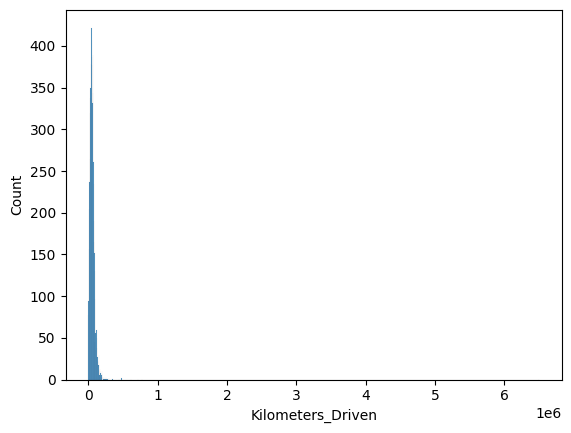

In [38]:
sns.histplot(data=df, x= df["Kilometers_Driven"])

- 이상치가 존재하기 때문에 히스토그램 분포가 제대로 나타나지 않음

In [39]:
df.shape

(7253, 17)

In [40]:
df.loc[df["Kilometers_Driven"]>1000000]

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
2328,BMW X5 xDrive 30d M Sport,Chennai,99642.4,2017,6500000,Diesel,Automatic,First,15.97,2993.0,258.0,5.0,BMW,1.0,Europe,high,3


- 이상치 확인
- 주행거리가 650만 km인 데이터 존재
- 차종을 고민하였을 때, Price가 거의 신차 가격과 유사
- 차종과 Price를 고려하면 주행거리가 650만 km인 것은 신뢰도가 떨어져 데이터 제거

In [41]:
df.drop(index = 2328, axis=0, inplace=True)

<Axes: xlabel='Kilometers_Driven', ylabel='Count'>

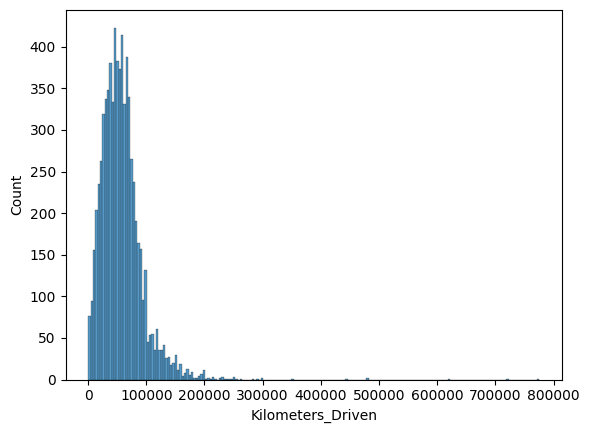

In [42]:
sns.histplot(data=df, x= df["Kilometers_Driven"])

- Right Skewed --> 회귀모델 적합시 Scailing 필요

-0.16722624514413645


<Axes: xlabel='Kilometers_Driven', ylabel='Price'>

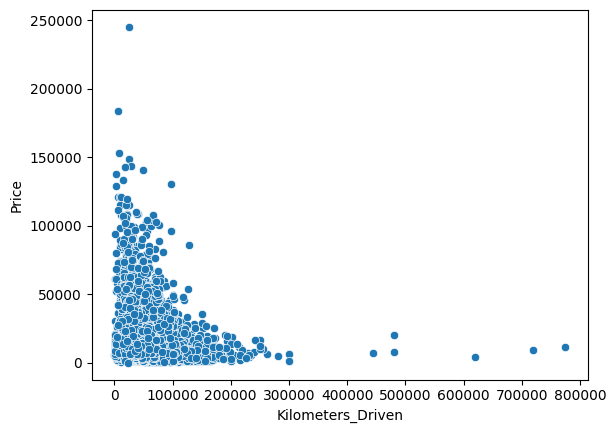

In [43]:
# 상관계수, 산점도 price ~ kilometer - price
print(df['Kilometers_Driven'].corr(df['Price']))
sns.scatterplot(data = df, x="Kilometers_Driven", y="Price")

- 상관계수는 작지만, 산점도 분포를 통해 음의 관계가 타나남

### Engine
    - 46개 결측치 직접 차량 정보 찾아서 입력

corr = 0.6397239922164708


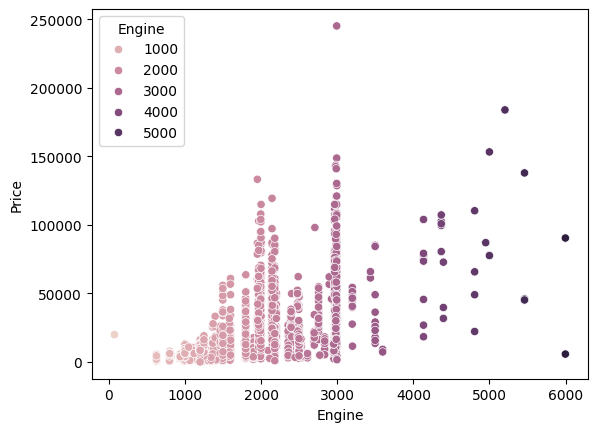

In [44]:
# 종속변수와의 관계
sns.scatterplot(data=df, x="Engine", y="Price", hue="Engine")
print("corr =",df['Engine'].corr(df['Price']))

- 엔진의 배기량이 클 수록 가격이 높아지는 경향이 보임
- 결측치 제거 전 상관도 0.640
- Engine의 최대치는 약 6000으로 이상치는 없다고 판단

In [45]:
# 결측치 인덱스
df[df['Engine'].isnull()].index

Int64Index([ 194,  208,  733,  749, 1294, 1327, 1385, 1460, 2074, 2096, 2264,
            2325, 2335, 2530, 2542, 2623, 2668, 2737, 2780, 2842, 3272, 3404,
            3520, 3522, 3810, 4011, 4152, 4229, 4577, 4604, 4697, 4712, 4952,
            5015, 5185, 5270, 6042, 6541, 6544, 6633, 6643, 6651, 6677, 6685,
            6880, 6902],
           dtype='int64')

In [46]:
# 직접 찾은 Engine, Power data
idx_ls = df[df['Engine'].isnull()].index
engine_ls = [1497, 1197, 1197, 2993, 1497, 1197, 1493, 2993, 1248, 999,
             1197, 1197, 1298, 1995, 999, 1995, 1197, 1061, 999, 999, 1995,
             1298, 1995, 999, 2354, 1248, 3000, 1086, 1995, 1198, 1172, 1086, 1368,
             1298, 1197, 1493, 1798, 1364, 1396, 2179, 1995, 1197, 1368, 1298,
             1995, 1197]
power_ls = [77, 83, 83, 242,98, 83, 100, 241, 75, 62, 80, 83, 87, 181, 62, 181, 85, 67, 210,
            62, 174, 87, 184, 62, 200, 76, 175, 210, 188, 90, 67, 62, 89, 89, 85, 100,
            158, 68, 99, 120, 175, 83, 90, 87, 177, 80]

In [47]:
# 결측치 채우기
for idx in range(len(idx_ls)):
    df.loc[idx_ls[idx],["Engine", "Power"]] = np.array([engine_ls[idx], power_ls[idx]])

In [48]:
df.isnull().sum()

Name                    0
Location                0
Price                1053
Year                    0
Kilometers_Driven       0
Fuel_Type               0
Transmission            0
Owner_Type              0
Mileage                 2
Engine                  0
Power                 129
Seats                  53
Brand                   0
Owner_Type_id           0
Brand_Country           0
Brand_level             0
Age                     0
dtype: int64

corr = 0.6407132277306332


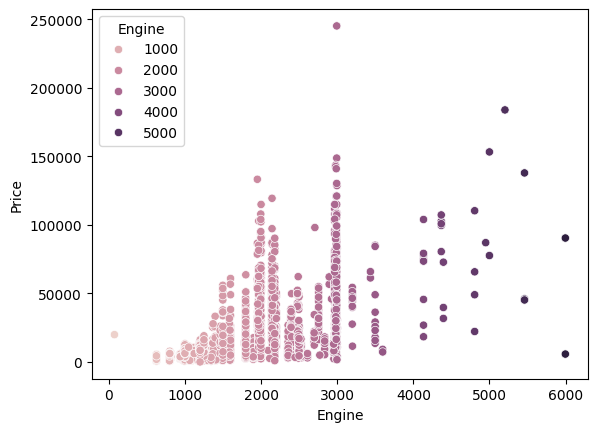

In [49]:
# 종속변수와의 관계
sns.scatterplot(data=df, x="Engine", y="Price", hue="Engine")
print("corr =", df['Engine'].corr(df['Price']))

### Seats
    - 결측치 채우기

In [50]:
## Seats 결측치 채우기
# Land Rover 7인승
# Mahindra TUV 300 P4 7인승
# 나머지 5인승

df.loc[df['Name'].str.contains('Land Rover'), 'Seats'] = 7
df.loc[df['Name'].str.contains('Mahindra'), 'Seats'] = 7
df['Seats'].fillna(5, inplace=True)

In [51]:
df.isnull().sum()

Name                    0
Location                0
Price                1053
Year                    0
Kilometers_Driven       0
Fuel_Type               0
Transmission            0
Owner_Type              0
Mileage                 2
Engine                  0
Power                 129
Seats                   0
Brand                   0
Owner_Type_id           0
Brand_Country           0
Brand_level             0
Age                     0
dtype: int64

### Power

<Axes: xlabel='Power', ylabel='Count'>

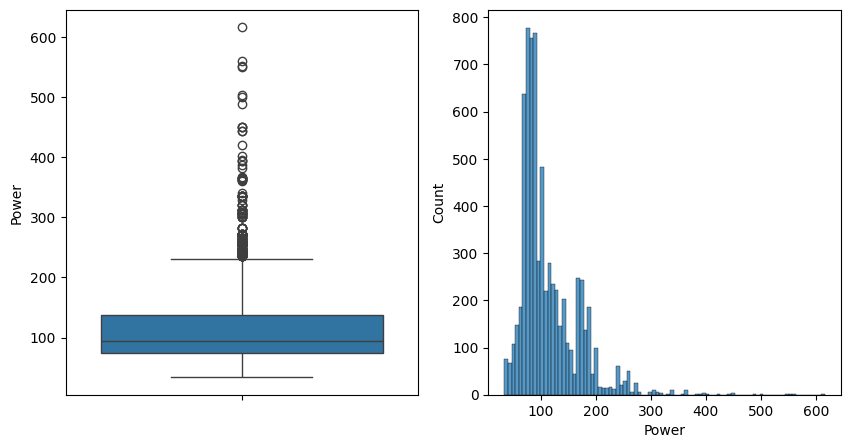

In [52]:
# plotting
fig, axes = plt.subplots(ncols=2, figsize=(10,5))

plt.subplot(121)
sns.boxplot(data=df, y= 'Power')

plt.subplot(122)
sns.histplot(data=df, x = 'Power')

- Right-Skewed 형태로 회귀분석 시 scailing 필요

<Axes: xlabel='Power', ylabel='Engine'>

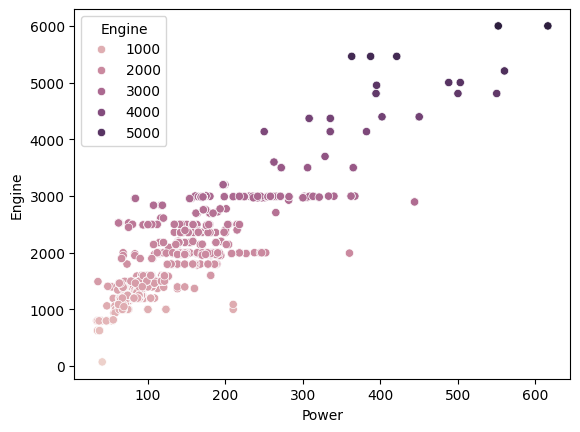

In [53]:
# Power와 Engine 관계
sns.scatterplot(data = df, x = "Power", y="Engine", hue="Engine")

<ipython-input-54-f0d2a78bfd61>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

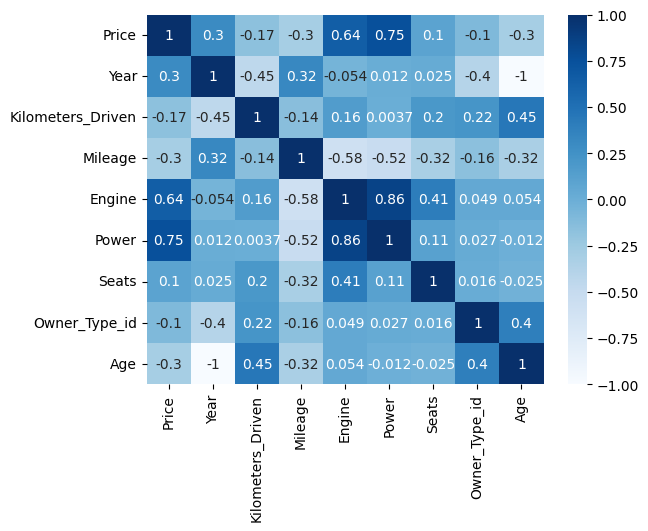

In [54]:
df_corr = df.corr()
sns.heatmap(data = df_corr, annot=True, cmap="Blues")

- Power와 Engine의 상관계수 = 0.86
- 매우 강한 선형관계가 있다고 판단
- Power ~ Engine의 1차 선형회귀를 통해 결측치 대체

In [55]:
# Power가 null인 dataframe
power_null_idx = df[df["Power"].isnull()].index
df_Engine_power_null = df.loc[~df.index.isin(power_null_idx), ['Engine']]
df_Power_power_null = df.loc[~df.index.isin(power_null_idx), ['Power']]
df_Engine_linear = df.loc[power_null_idx, ['Engine']]

In [56]:
# 회귀 적합
linear_model = LinearRegression()
linear_model.fit(df_Engine_power_null,df_Power_power_null)
Power_linear = linear_model.predict(df_Engine_linear)
df.loc[power_null_idx, "Power"] = Power_linear

In [57]:
df.isnull().sum()

Name                    0
Location                0
Price                1053
Year                    0
Kilometers_Driven       0
Fuel_Type               0
Transmission            0
Owner_Type              0
Mileage                 2
Engine                  0
Power                   0
Seats                   0
Brand                   0
Owner_Type_id           0
Brand_Country           0
Brand_level             0
Age                     0
dtype: int64

corr = 0.7538129662043411


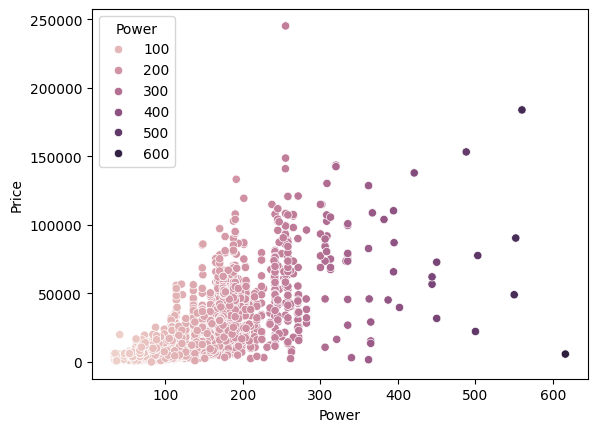

In [58]:
# power - price 산점도, 상관계수
# 종속변수와의 관계
sns.scatterplot(data=df, x="Power", y="Price", hue="Power")
print("corr =", df['Power'].corr(df['Price']))

- 상관계수 = 0.754로 높음
- 산점도가 양의 관계성이 보임
- Power가 Price를 설명하는 중요한 변수라고 판단

### Owner_Type_id

<Axes: xlabel='Owner_Type_id', ylabel='Price'>

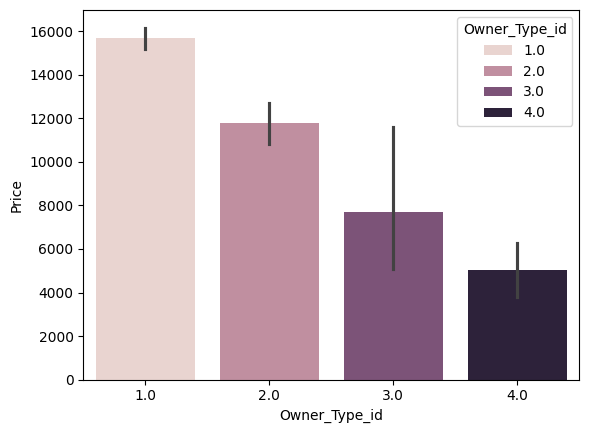

In [59]:
# first Owner가 압도적으로 많아 fourth 이상은 측정되지 않음.
sns.barplot(data = df, x= 'Owner_Type_id', y="Price", hue="Owner_Type_id")

- 주인을 거친 횟수가 많을 수록 Price가 낮아지는 것을 barplot을 통해 확인할 수 있다.

### Mileage
    - 결측값을 0으로 대체
    - 상관관계가 높은 Engine(Diesel, Petrol)을 이용하여 회귀적합하여 0인 값 대체

In [60]:
# null값인 Mileage
df[df['Mileage'].isnull()]

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
4446,Mahindra E Verito D4,Chennai,19928.48,2016,50000,Electric,Automatic,First,NaN,72.0,41.0,7.0,Mahindra,1.0,India,middle_high,4
4904,Toyota Prius 2009-2016 Z4,Mumbai,19545.24,2011,44000,Electric,Automatic,First,NaN,1798.0,73.0,5.0,Toyota,1.0,Japan,middle_high,9


- 전기차 -> 연비가 없어 0으로 대체

In [61]:
# 0으로 들어간 Mileage
df[df["Mileage"]==0]

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
14,Land Rover Freelander 2 TD4 SE,Pune,26826.80,2012,85000,Diesel,Automatic,Second,0.0,2179.0,115.000000,7.0,Land,2.0,Europe,high,8
67,Mercedes-Benz C-Class Progressive C 220d,Coimbatore,54680.68,2019,15369,Diesel,Automatic,First,0.0,1950.0,194.000000,5.0,Mercedes-Benz,1.0,Europe,high,1
79,Hyundai Santro Xing XL,Hyderabad,1992.85,2005,87591,Petrol,Manual,First,0.0,1086.0,71.584186,5.0,Hyundai,1.0,Korea,middle_low,15
194,Honda City 1.5 GXI,Ahmedabad,4522.23,2007,60006,Petrol,Manual,First,0.0,1497.0,77.000000,5.0,Honda,1.0,Japan,middle_low,13
229,Ford Figo Diesel,Bangalore,5518.66,2015,70436,Diesel,Manual,First,0.0,1498.0,99.000000,5.0,Ford,1.0,US,middle_low,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6633,Mahindra TUV 300 P4,Kolkata,NaN,2016,27000,Diesel,Manual,First,0.0,2179.0,120.000000,7.0,Mahindra,1.0,India,middle_high,4
6697,Hyundai Santro Xing XL,Jaipur,NaN,2007,85000,Petrol,Manual,Second,0.0,1086.0,71.584186,5.0,Hyundai,2.0,Korea,middle_low,13
6857,Land Rover Freelander 2 TD4 SE,Mumbai,NaN,2011,87000,Diesel,Automatic,First,0.0,2179.0,115.000000,7.0,Land,1.0,Europe,high,9
6957,Honda Jazz 2020 Petrol,Kochi,NaN,2019,11574,Petrol,Manual,First,0.0,1199.0,88.700000,5.0,Honda,1.0,Japan,middle_low,1


In [62]:
# Mileage 결측값 0으로 채우기
df.loc[4446, "Mileage"] = 0
df.loc[4904, "Mileage"] = 0

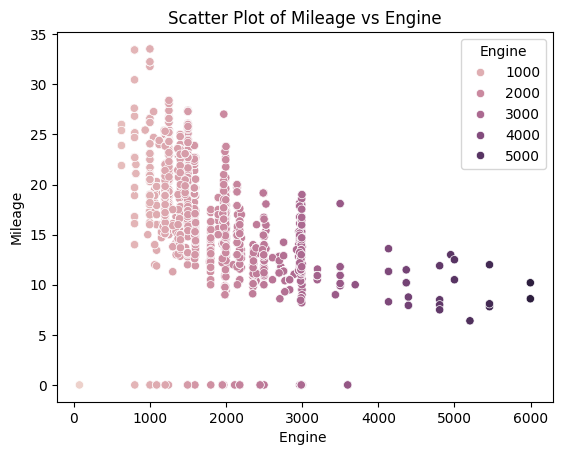

In [63]:
# Mileage, Engine 관계(상관계수 0.59)
sns.scatterplot(x='Engine', y='Mileage', data=df, hue='Engine')

plt.title('Scatter Plot of Mileage vs Engine')
plt.xlabel('Engine ')
plt.ylabel('Mileage')

plt.legend(title='Engine')

plt.show()

<Axes: xlabel='Fuel_Type', ylabel='Mileage'>

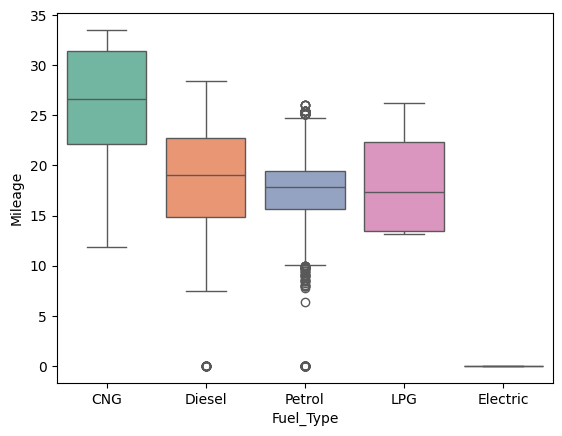

In [64]:
# 연료별 Mileage
sns.boxplot(x='Fuel_Type', y='Mileage', data=df, hue = "Fuel_Type", palette="Set2")

- Mileage와 Engine의 상관관계 :  -0.59
- 결측값(0)을 제외하면 더 강한 선형성을 띔
- 경유차와 휘발유차의 연비가 차이가 있음을 고려
- 경유차와 휘발유차를 구분하여 Mileage ~ Engine 선형회귀를 통해 결측치 대체

In [65]:
## Diesel
# Mileage가 0인 dataframe
Diesel_Mileage_null_idx = df.loc[(df["Mileage"]==0) & (df["Fuel_Type"]=="Diesel") ].index      ## Diesel & Mileage =0인 idx
df_Engine_Diesel_Mileage_notnull = df.loc[~df.index.isin(Diesel_Mileage_null_idx), ['Engine']]    ## Diesel & Mileage =0인걸 제외한 Engine
df_Mileage_Diesel_Mileage_notnull = df.loc[~df.index.isin(Diesel_Mileage_null_idx), ['Mileage']]  ## Diesel & Mileage =0인걸 제외한 Mileage
df_Engine_linear_Mileage_null = df.loc[Diesel_Mileage_null_idx, ['Engine']]  ## Diesel & Mileage =0인 Engine

In [66]:
# Mileage_Diesel 회귀 적합
linear_model_Diesel = LinearRegression()
linear_model_Diesel.fit(y = df_Mileage_Diesel_Mileage_notnull, X = df_Engine_Diesel_Mileage_notnull)
Mileage_Diesel_linear = linear_model_Diesel.predict(df_Engine_linear_Mileage_null)
df.loc[Diesel_Mileage_null_idx, "Mileage"] = Mileage_Diesel_linear

In [67]:
## Petrol
# Mileage가 0인 dataframe
Petrol_Mileage_null_idx = df.loc[(df["Mileage"]==0) & (df["Fuel_Type"]=="Petrol") ].index      ## Petrol & Mileage =0인 idx
df_Engine_Petrol_Mileage_notnull = df.loc[~df.index.isin(Petrol_Mileage_null_idx), ['Engine']]    ## Petrol & Mileage =0인걸 제외한 Engine
df_Mileage_Petrol_Mileage_notnull = df.loc[~df.index.isin(Petrol_Mileage_null_idx), ['Mileage']]  ## Petrol & Mileage =0인걸 제외한 Mileage
df_Engine_linear_Mileage_null = df.loc[Petrol_Mileage_null_idx, ['Engine']]  ## Petrol & Mileage =0인 Engine

In [68]:
# Mileage_Petrol 회귀 적합
linear_model_Petrol = LinearRegression()
linear_model_Petrol.fit(X = df_Engine_Petrol_Mileage_notnull, y = df_Mileage_Petrol_Mileage_notnull)
Mileage_Petrol_linear = linear_model_Petrol.predict(df_Engine_linear_Mileage_null)
df.loc[Petrol_Mileage_null_idx, "Mileage"] = Mileage_Petrol_linear

In [69]:
df.head()

,Name,Location,Price,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
0,Maruti Wagon R LXI CNG,Mumbai,2682.68,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,Maruti,1.0,India,middle_low,10
1,Hyundai Creta 1.6 CRDi SX Option,Pune,19162.00,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,Hyundai,1.0,Korea,middle_low,5
2,Honda Jazz V,Chennai,6898.32,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,Honda,1.0,Japan,middle_low,9
3,Maruti Ertiga VDI,Chennai,9197.76,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,Maruti,1.0,India,middle_low,8
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,27194.71,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,Audi,2.0,Europe,high,7


corr = -0.3300250188556865


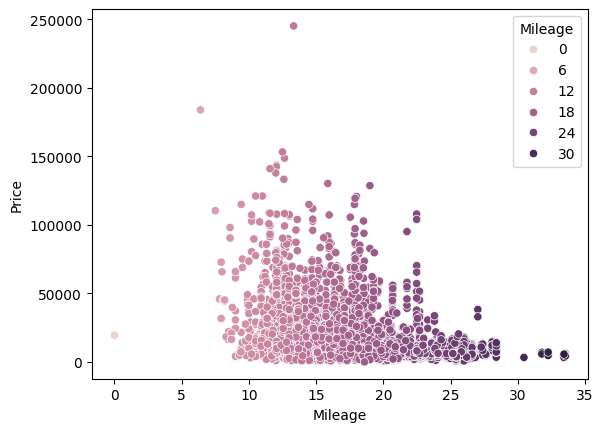

In [70]:
# price ~ mileage 산점도 상관계수

sns.scatterplot(data=df, x="Mileage", y="Price", hue="Mileage")
print("corr =", df['Mileage'].corr(df['Price']))

- Price와 mileage의 상관게수 : -0.33
- scatterplot을 보면 강하지는 않지만 음의 관계를 갖는다는 것을 확인
- Mileage = 0 -> 전기차

## 설명변수간 관계

In [71]:
# 수치형 칼럼만 뽑아냄
num_columns = df.select_dtypes(include=['int','float']).columns

In [72]:
df_num = df[num_columns]
df_num

,Price,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age
0,2682.68,2010,72000,26.60,998.0,58.16,5.0,1.0,10
1,19162.00,2015,41000,19.67,1582.0,126.20,5.0,1.0,5
2,6898.32,2011,46000,18.20,1199.0,88.70,5.0,1.0,9
3,9197.76,2012,87000,20.77,1248.0,88.76,7.0,1.0,8
4,27194.71,2013,40670,15.20,1968.0,140.80,5.0,2.0,7
...,...,...,...,...,...,...,...,...,...
7248,NaN,2011,89411,20.54,1598.0,103.60,5.0,1.0,9
7249,NaN,2015,59000,17.21,1197.0,103.60,5.0,1.0,5
7250,NaN,2012,28000,23.08,1461.0,63.10,5.0,1.0,8
7251,NaN,2013,52262,17.20,1197.0,103.60,5.0,3.0,7


In [73]:
df_num1 = df_num.drop(columns = 'Price')
df_num1

,Year,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age
0,2010,72000,26.60,998.0,58.16,5.0,1.0,10
1,2015,41000,19.67,1582.0,126.20,5.0,1.0,5
2,2011,46000,18.20,1199.0,88.70,5.0,1.0,9
3,2012,87000,20.77,1248.0,88.76,7.0,1.0,8
4,2013,40670,15.20,1968.0,140.80,5.0,2.0,7
...,...,...,...,...,...,...,...,...
7248,2011,89411,20.54,1598.0,103.60,5.0,1.0,9
7249,2015,59000,17.21,1197.0,103.60,5.0,1.0,5
7250,2012,28000,23.08,1461.0,63.10,5.0,1.0,8
7251,2013,52262,17.20,1197.0,103.60,5.0,3.0,7


<Axes: >

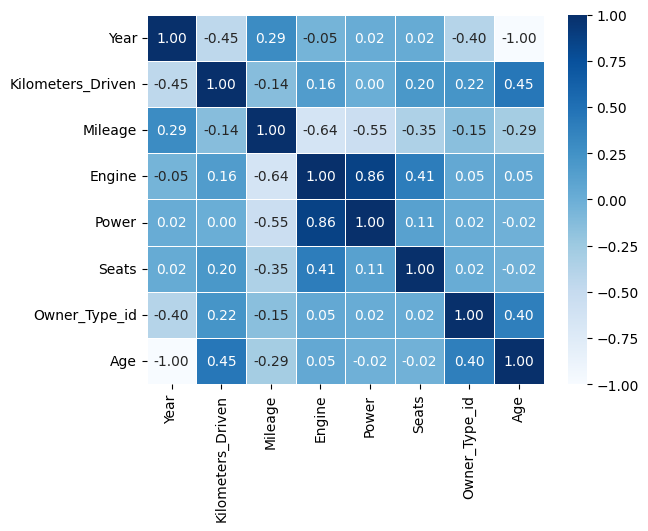

In [74]:
sns.heatmap(data = df_num1.corr(), annot=True,
fmt = '.2f', linewidths=.5, cmap='Blues')

- Engine , Mileage : -0.64 음의 상관관계 가짐
- Engine, Power : 0.86 강한 양의 상관관계 가짐.
- Power, Mileage : -0.55 음의 상관관계 가짐.


<Axes: xlabel='Engine', ylabel='Mileage'>

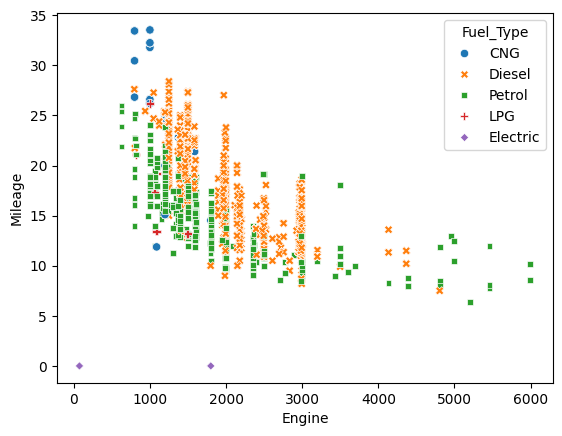

In [75]:
# Engine vs Mileage
sns.scatterplot(x = 'Engine', y = 'Mileage', hue = 'Fuel_Type', style = 'Fuel_Type', data = df)

- 엔진이 증가함에 따라 마일리지 값은 감소

- Fuel_type의 분포를 확인해 본 결과 높은 엔진마력을 가질 때에는 연료로 Petrol을 사용하는 경향을 보임

- Petrol과 Diesel을 비교시, 동일 엔진일 때 Mileage 값을 나타내는 경향을 보임

<Axes: xlabel='Power', ylabel='Engine'>

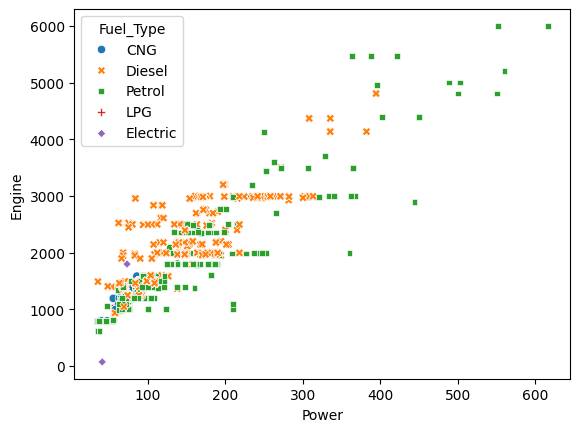

In [76]:
# Engine vs Power
sns.scatterplot(x = 'Power', y = 'Engine', hue = 'Fuel_Type', style = 'Fuel_Type', data = df)

- power와 engine은 매우 강한 상관관계를 나타내며 선형성을 띄고 있음

- 강한 power인 경우, 연료로 Petrol을 사용하는 경향을 보임

- Petrol과 Diesel을 비교시, 동일 엔진일 때 Mileage 값을 나타내는 경향을 보임

<Axes: xlabel='Power', ylabel='Mileage'>

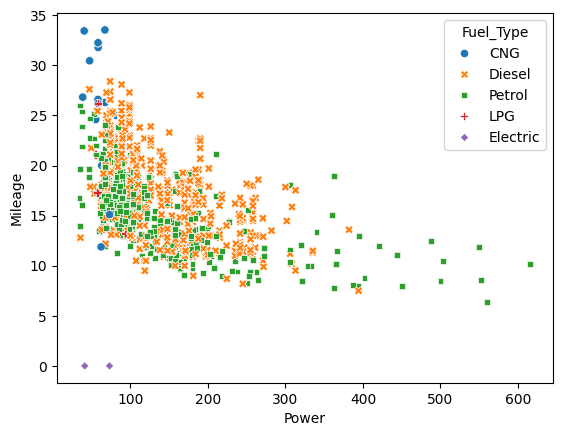

In [77]:
# Power vs Mileage
sns.scatterplot(x = 'Power', y = 'Mileage', hue = 'Fuel_Type', style = 'Fuel_Type', data = df)

- Diesel이 Petrol보다 높은 Mileage 나타냄

# Data split

In [78]:
# 목표변수/설명변수 분리
df_raw_x = df.drop("Price", axis = 1, inplace = False)
df_raw_y = df["Price"]

display("설명변수:", df_raw_x.head())
display("목표변수:",df_raw_y.head())

'설명변수:'

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
0,Maruti Wagon R LXI CNG,Mumbai,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,Maruti,1.0,India,middle_low,10
1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,Hyundai,1.0,Korea,middle_low,5
2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,Honda,1.0,Japan,middle_low,9
3,Maruti Ertiga VDI,Chennai,2012,87000,Diesel,Manual,First,20.77,1248.0,88.76,7.0,Maruti,1.0,India,middle_low,8
4,Audi A4 New 2.0 TDI Multitronic,Coimbatore,2013,40670,Diesel,Automatic,Second,15.20,1968.0,140.80,5.0,Audi,2.0,Europe,high,7


'목표변수:'

0     2682.68
1    19162.00
2     6898.32
3     9197.76
4    27194.71
Name: Price, dtype: float64

In [79]:
# 범주형 변수 선택 : select_dtypes="object"
df_raw_x_char = df_raw_x.select_dtypes(include = "object")
df_raw_x_char.drop(columns=['Name','Owner_Type','Brand_Country','Brand_level'],inplace=True) # Brand를 남김
df_raw_x_char.head()

,Location,Fuel_Type,Transmission,Brand
0,Mumbai,CNG,Manual,Maruti
1,Pune,Diesel,Manual,Hyundai
2,Chennai,Petrol,Manual,Honda
3,Chennai,Diesel,Manual,Maruti
4,Coimbatore,Diesel,Automatic,Audi


In [80]:
# get_dummies: 범주형 변수에 대한 더미변환
df_x_dummy = pd.get_dummies(df_raw_x_char)
df_x_dummy.head()

display("Dummy 변환 전:", df_raw_x_char.head())
display("Dummy 변환 후:",df_x_dummy.head())

'Dummy 변환 전:'

,Location,Fuel_Type,Transmission,Brand
0,Mumbai,CNG,Manual,Maruti
1,Pune,Diesel,Manual,Hyundai
2,Chennai,Petrol,Manual,Honda
3,Chennai,Diesel,Manual,Maruti
4,Coimbatore,Diesel,Automatic,Audi


'Dummy 변환 후:'

,Location_Ahmedabad,Location_Bangalore,Location_Chennai,Location_Coimbatore,Location_Delhi,Location_Hyderabad,Location_Jaipur,Location_Kochi,Location_Kolkata,Location_Mumbai,...,Brand_Nissan,Brand_OpelCorsa,Brand_Porsche,Brand_Renault,Brand_Skoda,Brand_Smart,Brand_Tata,Brand_Toyota,Brand_Volkswagen,Brand_Volvo
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [81]:
# 연속형 변수 선택 : select_dtypes="object" 제외
df_raw_x_num = df_raw_x.select_dtypes(exclude = "object")
df_raw_x_num.drop(columns=['Year',],inplace=True)
df_raw_x_num

# 변수명 저장
v_feature_names = df_raw_x_num.columns

In [82]:
from sklearn.preprocessing import StandardScaler
# StandardScaler 적용
scaler = StandardScaler()
df_x_scaled = scaler.fit_transform(df_raw_x_num)
df_x_scaled = pd.DataFrame(df_x_scaled, columns=v_feature_names,index=df_raw_x_num.index)


In [83]:
df_x_scaled

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age
0,0.378408,1.984952,-1.038739,-1.018576,-0.362272,-0.441328,1.034026
1,-0.448326,0.320255,-0.056761,0.258055,-0.362272,-0.441328,-0.502478
2,-0.314982,-0.032862,-0.700764,-0.445555,-0.362272,-0.441328,0.726725
3,0.778441,0.584493,-0.618372,-0.444430,2.115044,-0.441328,0.419424
4,-0.457127,-0.753510,0.592286,0.531995,-0.362272,1.747804,0.112123
...,...,...,...,...,...,...,...
7248,0.842739,0.529243,-0.029858,-0.165987,-0.362272,-0.441328,0.726725
7249,0.031713,-0.270676,-0.704127,-0.165987,-0.362272,-0.441328,-0.502478
7250,-0.795021,1.139392,-0.260219,-0.925887,-0.362272,-0.441328,0.419424
7251,-0.147981,-0.273078,-0.704127,-0.165987,-0.362272,3.936936,0.112123


In [84]:
display("원래 설명변수:", df_raw_x.head(3))

# 원래 연속형(df_raw_x_num) + 원래 범주형(df_raw_x_char)
df_x_raw_raw = df_raw_x_num.join(df_raw_x_char)
display("원래 연속형+ 원래 범주형...회귀분석용: ", df_x_raw_raw.head(3))

# 원래 연속형(df_raw_x_num) + dummy된 범주형(df_x_dummy)
df_x_raw_dummy = df_raw_x_num.join(df_x_dummy)
display("원래 연속형+ Dummied 범주형...DT/RF/GB 용:",df_x_raw_dummy.head(3))

# scale된 연속형(df_x_scaled)+ dummy된 범주형(df_x_dummy)
df_x_scale_dummy = df_x_scaled.join(df_x_dummy)
display("Scaled 연속형+ Dummied 범주형...SVM/NN/KNN 용:",df_x_scale_dummy.head(3))

# scale된 연속형(df_x_scaled) + 원래 범주형(df_raw_x_char)
df_x_scale_raw = df_x_scaled.join(df_raw_x_char)
display("Scaled 연속형+ 원래 범주형...회귀분석용(표준화 회귀계수):",df_x_scale_raw.head(3))

'원래 설명변수:'

,Name,Location,Year,Kilometers_Driven,Fuel_Type,Transmission,Owner_Type,Mileage,Engine,Power,Seats,Brand,Owner_Type_id,Brand_Country,Brand_level,Age
0,Maruti Wagon R LXI CNG,Mumbai,2010,72000,CNG,Manual,First,26.60,998.0,58.16,5.0,Maruti,1.0,India,middle_low,10
1,Hyundai Creta 1.6 CRDi SX Option,Pune,2015,41000,Diesel,Manual,First,19.67,1582.0,126.20,5.0,Hyundai,1.0,Korea,middle_low,5
2,Honda Jazz V,Chennai,2011,46000,Petrol,Manual,First,18.20,1199.0,88.70,5.0,Honda,1.0,Japan,middle_low,9


'원래 연속형+ 원래 범주형...회귀분석용: '

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location,Fuel_Type,Transmission,Brand
0,72000,26.60,998.0,58.16,5.0,1.0,10,Mumbai,CNG,Manual,Maruti
1,41000,19.67,1582.0,126.20,5.0,1.0,5,Pune,Diesel,Manual,Hyundai
2,46000,18.20,1199.0,88.70,5.0,1.0,9,Chennai,Petrol,Manual,Honda


'원래 연속형+ Dummied 범주형...DT/RF/GB 용:'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location_Ahmedabad,Location_Bangalore,Location_Chennai,...,Brand_Nissan,Brand_OpelCorsa,Brand_Porsche,Brand_Renault,Brand_Skoda,Brand_Smart,Brand_Tata,Brand_Toyota,Brand_Volkswagen,Brand_Volvo
0,72000,26.60,998.0,58.16,5.0,1.0,10,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,41000,19.67,1582.0,126.20,5.0,1.0,5,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,46000,18.20,1199.0,88.70,5.0,1.0,9,0,0,1,...,0,0,0,0,0,0,0,0,0,0


'Scaled 연속형+ Dummied 범주형...SVM/NN/KNN 용:'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location_Ahmedabad,Location_Bangalore,Location_Chennai,...,Brand_Nissan,Brand_OpelCorsa,Brand_Porsche,Brand_Renault,Brand_Skoda,Brand_Smart,Brand_Tata,Brand_Toyota,Brand_Volkswagen,Brand_Volvo
0,0.378408,1.984952,-1.038739,-1.018576,-0.362272,-0.441328,1.034026,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,-0.448326,0.320255,-0.056761,0.258055,-0.362272,-0.441328,-0.502478,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,-0.314982,-0.032862,-0.700764,-0.445555,-0.362272,-0.441328,0.726725,0,0,1,...,0,0,0,0,0,0,0,0,0,0


'Scaled 연속형+ 원래 범주형...회귀분석용(표준화 회귀계수):'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location,Fuel_Type,Transmission,Brand
0,0.378408,1.984952,-1.038739,-1.018576,-0.362272,-0.441328,1.034026,Mumbai,CNG,Manual,Maruti
1,-0.448326,0.320255,-0.056761,0.258055,-0.362272,-0.441328,-0.502478,Pune,Diesel,Manual,Hyundai
2,-0.314982,-0.032862,-0.700764,-0.445555,-0.362272,-0.441328,0.726725,Chennai,Petrol,Manual,Honda


In [85]:
submission_dummy = df_x_raw_dummy.loc[df_raw_y[df_raw_y.isnull()].index]
df_x_raw_dummy_sub = df_x_raw_dummy.drop(submission_dummy.index)
df_raw_y_dummy = df_raw_y.drop(submission_dummy.index)

df_x_raw_raw_sub = df_x_raw_raw.drop(submission_dummy.index)

# 원래 연속형 + 원래 범주형
df_train_x, df_test_x, df_train_y, df_test_y = train_test_split(df_x_raw_raw_sub, df_raw_y_dummy
                                    , test_size = 0.3, random_state = 1234)
display("원래 연속형+ 원래 범주형...회귀분석 용:", df_train_x.head())

# 원래 연속형+ Dummied 범주형...DT/RF/GB 용:df_x_raw_dummy
df_train_x_rd, df_test_x_rd, df_train_y, df_test_y = train_test_split(df_x_raw_dummy_sub, df_raw_y_dummy
                                    , test_size = 0.3, random_state = 1234)
display("원래 연속형+ Dummied 범주형...DT/RF/GB 용:", df_train_x_rd.head())


submission_sd = df_x_raw_dummy.loc[df_raw_y[df_raw_y.isnull()].index]
df_x_raw_sd_sub = df_x_scale_dummy.drop(submission_sd.index)
df_raw_y_sd = df_raw_y.drop(submission_sd.index)

# 기계학습용 데이터(Scaled 연속형+ Dummied 범주형) 분할:df_x_scale_dummy
df_train_x_sd, df_test_x_sd, df_train_y, df_test_y = train_test_split(df_x_raw_sd_sub, df_raw_y_sd
                                    , test_size = 0.3, random_state = 1234)
display("Scaled 연속형+ Dummied 범주형...SVM/NN/KNN 용:", df_train_x_sd.head())

submission_reg = df_x_scale_raw.loc[df_raw_y[df_raw_y.isnull()].index]
df_x_raw_reg_sub = df_x_scale_raw.drop(submission_reg.index)
df_raw_y_reg = df_raw_y.drop(submission_reg.index)

# 회귀분석용(표준화 회귀계수) 데이터(Scaled 연속형+ 원래 범주형) 분할:df_x_scale_raw
df_train_x_reg, df_test_x_reg, df_train_y, df_test_y = train_test_split(df_x_raw_reg_sub, df_raw_y_reg
                                    , test_size = 0.3, random_state = 1234)
display("Scaled 연속형+ 원래 범주형...회귀분석용(표준화 회귀계수):",df_train_x_reg.head())

'원래 연속형+ 원래 범주형...회귀분석 용:'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location,Fuel_Type,Transmission,Brand
5226,140000,15.10,2179.0,140.00,7.0,2.0,7,Hyderabad,Diesel,Manual,Mahindra
2927,30000,23.10,998.0,67.04,5.0,2.0,4,Jaipur,Petrol,Automatic,Maruti
475,64284,17.72,1968.0,108.49,5.0,1.0,8,Kolkata,Diesel,Manual,Skoda
2814,54540,17.50,1298.0,85.80,5.0,3.0,11,Mumbai,Petrol,Manual,Maruti
436,34267,22.74,796.0,47.30,5.0,1.0,4,Kochi,Petrol,Manual,Maruti


'원래 연속형+ Dummied 범주형...DT/RF/GB 용:'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location_Ahmedabad,Location_Bangalore,Location_Chennai,...,Brand_Nissan,Brand_OpelCorsa,Brand_Porsche,Brand_Renault,Brand_Skoda,Brand_Smart,Brand_Tata,Brand_Toyota,Brand_Volkswagen,Brand_Volvo
5226,140000,15.10,2179.0,140.00,7.0,2.0,7,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2927,30000,23.10,998.0,67.04,5.0,2.0,4,0,0,0,...,0,0,0,0,0,0,0,0,0,0
475,64284,17.72,1968.0,108.49,5.0,1.0,8,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2814,54540,17.50,1298.0,85.80,5.0,3.0,11,0,0,0,...,0,0,0,0,0,0,0,0,0,0
436,34267,22.74,796.0,47.30,5.0,1.0,4,0,0,0,...,0,0,0,0,0,0,0,0,0,0


'Scaled 연속형+ Dummied 범주형...SVM/NN/KNN 용:'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location_Ahmedabad,Location_Bangalore,Location_Chennai,...,Brand_Nissan,Brand_OpelCorsa,Brand_Porsche,Brand_Renault,Brand_Skoda,Brand_Smart,Brand_Tata,Brand_Toyota,Brand_Volkswagen,Brand_Volvo
5226,2.191889,-0.777532,0.947076,0.516984,2.115044,1.747804,0.112123,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2927,-0.741683,1.144196,-1.038739,-0.851961,-0.362272,1.747804,-0.809779,0,0,0,...,0,0,0,0,0,0,0,0,0,0
475,0.172631,-0.148166,0.592286,-0.074236,-0.362272,-0.441328,0.419424,0,0,0,...,0,0,0,0,1,0,0,0,0,0
2814,-0.087230,-0.201013,-0.534298,-0.499968,-0.362272,3.936936,1.341326,0,0,0,...,0,0,0,0,0,0,0,0,0,0
436,-0.627887,1.057718,-1.378396,-1.222342,-0.362272,-0.441328,-0.809779,0,0,0,...,0,0,0,0,0,0,0,0,0,0


'Scaled 연속형+ 원래 범주형...회귀분석용(표준화 회귀계수):'

,Kilometers_Driven,Mileage,Engine,Power,Seats,Owner_Type_id,Age,Location,Fuel_Type,Transmission,Brand
5226,2.191889,-0.777532,0.947076,0.516984,2.115044,1.747804,0.112123,Hyderabad,Diesel,Manual,Mahindra
2927,-0.741683,1.144196,-1.038739,-0.851961,-0.362272,1.747804,-0.809779,Jaipur,Petrol,Automatic,Maruti
475,0.172631,-0.148166,0.592286,-0.074236,-0.362272,-0.441328,0.419424,Kolkata,Diesel,Manual,Skoda
2814,-0.087230,-0.201013,-0.534298,-0.499968,-0.362272,3.936936,1.341326,Mumbai,Petrol,Manual,Maruti
436,-0.627887,1.057718,-1.378396,-1.222342,-0.362272,-0.441328,-0.809779,Kochi,Petrol,Manual,Maruti


- 범주형 변수 dummy 변환, 연속형 범주 scaling(StandardScaler) 진행
- 각 모델을 위해 범주형 변수와 연속형 변수를 더해서 데이터를 따로 준비
- train, test 7:3으로 구분
- 결측치를 예측하기 위해 submission 표현 및 예측할 값으로 선정

# Modeling

## Regression

*   적합 변수
    * 목표변수: Price   
    * 설명변수 (범주형): C(Location), C(Brand),  C(Fuel_Type), C(Transmission)   
    * Kilometers_Driven, Mileage, Engine, Power, Seats, Owner_Type_id, Age  
*   Backward elimination.

### fit & train
*  backward elimination을 통해 회귀계수를 선택한다.

In [86]:
df_train_rg = pd.concat([df_train_y, df_train_x], axis=1)
df_test_rg = pd.concat([df_test_y, df_test_x], axis=1)

print(df_train_rg.shape)
print(df_test_rg.shape)

(4339, 12)
(1860, 12)


In [87]:
# 1차 적합(모든 변수)
reg_model = smf.ols(formula = "Price~ C(Location) + C(Brand) + C(Fuel_Type) + C(Transmission) +\
 Kilometers_Driven + Mileage + Engine + Power + Seats + Owner_Type_id + Age", data = df_train_rg)
reg_result = reg_model.fit()

print(reg_result.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.764
Model:                            OLS   Adj. R-squared:                  0.761
Method:                 Least Squares   F-statistic:                     277.9
Date:                Sat, 09 Mar 2024   Prob (F-statistic):               0.00
Time:                        16:36:43   Log-Likelihood:                -45400.
No. Observations:                4339   AIC:                         9.090e+04
Df Residuals:                    4288   BIC:                         9.123e+04
Df Model:                          50                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

In [88]:
## VIF(숫자형 변수만)
# 숫자형 변수만 추출
df_train_x_num = df_train_x.select_dtypes(include='number')

# 상수항 추가
df_train_x_const = add_constant(df_train_x_num)  #### 숫자형 변수만 있는 X_train 넣어서 VIF
# vif dataframe 만들기
df_vif = pd.DataFrame()
df_vif['variable'] = df_train_x_const.columns
df_vif["VIF"] = [variance_inflation_factor(df_train_x_const.values, i) for i in range(df_train_x_const.shape[1])]
df_vif.sort_values("VIF", ascending=False).round(2)

,variable,VIF
0,const,185.60
3,Engine,7.18
4,Power,5.80
2,Mileage,2.05
5,Seats,1.76
7,Age,1.65
1,Kilometers_Driven,1.37
6,Owner_Type_id,1.18


- 회귀분석 1차 적합 결과
    - R2 = 0.764 / adjR2 = 0.761
    - C(Transmission)[T.Manual]의 p-value = 0.643 > 0.05로 유의수준 5% 하에서 유의하지 않음
    - C(Transmission)[T.Manual]를 제외하고 다시 적합
- VIF 확인
    - 10 이상인 숫자형 변수 없음

In [89]:
# 2차 적합(C(Transmission) 제외)
reg_model = smf.ols(formula = "Price~ C(Location) + C(Brand) + C(Fuel_Type) +\
 Kilometers_Driven + Mileage + Engine + Power + Seats + Owner_Type_id + Age", data = df_train_rg)
reg_result = reg_model.fit()

print(reg_result.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.764
Model:                            OLS   Adj. R-squared:                  0.761
Method:                 Least Squares   F-statistic:                     283.6
Date:                Sat, 09 Mar 2024   Prob (F-statistic):               0.00
Time:                        16:36:43   Log-Likelihood:                -45400.
No. Observations:                4339   AIC:                         9.090e+04
Df Residuals:                    4289   BIC:                         9.122e+04
Df Model:                          49                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

- 회귀분석 2차 적합 결과
    - R2 = 0.764 / adjR2 = 0.761
    - Mileage의 p-value = 0.186 > 0.05로 유의수준 5%에서 유의하지 않음
    - Mileage를 제외하고 다시 적합

In [90]:
# 3차 적합(C(Transmission), Mileage 제외)
reg_model = smf.ols(formula = "Price~ C(Location) + C(Brand) + C(Fuel_Type) +\
 Kilometers_Driven + Engine + Power + Seats + Owner_Type_id + Age", data = df_train_rg)
reg_result = reg_model.fit()

print(reg_result.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.764
Model:                            OLS   Adj. R-squared:                  0.761
Method:                 Least Squares   F-statistic:                     289.4
Date:                Sat, 09 Mar 2024   Prob (F-statistic):               0.00
Time:                        16:36:43   Log-Likelihood:                -45401.
No. Observations:                4339   AIC:                         9.090e+04
Df Residuals:                    4290   BIC:                         9.121e+04
Df Model:                          48                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

In [91]:
## VIF(숫자형 변수만)
# 숫자형 변수만 추출
df_train_x_num = df_train_x.select_dtypes(include='number').drop(columns = ["Mileage"]) # Mileage 제거

# 상수항 추가
df_train_x_const = add_constant(df_train_x_num)  #### 숫자형 변수만 있는 X_train 넣어서 VIF
# vif dataframe 만들기
df_vif = pd.DataFrame()
df_vif['variable'] = df_train_x_const.columns
df_vif["VIF"] = [variance_inflation_factor(df_train_x_const.values, i) for i in range(df_train_x_const.shape[1])]
df_vif.sort_values("VIF", ascending=False).round(2)

,variable,VIF
0,const,64.98
2,Engine,6.83
3,Power,5.74
4,Seats,1.68
6,Age,1.44
1,Kilometers_Driven,1.35
5,Owner_Type_id,1.18


- 회귀분석 3차 적합 결과
    - R2 = 0.764 / adjR2 = 0.761
    - Owner_Type_id의 p-value = 0.160 > 0.05로 유의수준 5% 하에서 유의하지 않음
    - Owner_Type_id를 제외하고 다시 적합
- VIF 확인
    - 10 이상인 숫자형 변수 없음

In [92]:
# 4차 적합(C(Transmission), Mileage, Owner_Type_id 제외)
reg_model = smf.ols(formula = "Price~ C(Location) + C(Brand) + C(Fuel_Type) +\
 Kilometers_Driven + Engine + Power + Seats +  Age", data = df_train_rg)
reg_result = reg_model.fit()

print(reg_result.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.764
Model:                            OLS   Adj. R-squared:                  0.761
Method:                 Least Squares   F-statistic:                     295.5
Date:                Sat, 09 Mar 2024   Prob (F-statistic):               0.00
Time:                        16:36:44   Log-Likelihood:                -45402.
No. Observations:                4339   AIC:                         9.090e+04
Df Residuals:                    4291   BIC:                         9.121e+04
Df Model:                          47                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

In [93]:
## VIF(숫자형 변수만)
# 숫자형 변수만 추출
df_train_x_num = df_train_x.select_dtypes(include='number').drop(columns = ["Mileage", "Owner_Type_id"]) # Mileage, Owner_Type_id 제거

# 상수항 추가
df_train_x_const = add_constant(df_train_x_num)  #### 숫자형 변수만 있는 X_train 넣어서 VIF
# vif dataframe 만들기
df_vif = pd.DataFrame()
df_vif['variable'] = df_train_x_const.columns
df_vif["VIF"] = [variance_inflation_factor(df_train_x_const.values, i) for i in range(df_train_x_const.shape[1])]
df_vif.sort_values("VIF", ascending=False).round(2)

,variable,VIF
0,const,61.73
2,Engine,6.83
3,Power,5.73
4,Seats,1.68
1,Kilometers_Driven,1.35
5,Age,1.28


- 회귀분석 4차 적합 결과
    - R2 = 0.764 / adjR2 = 0.761
    - p-value가 0.05 이하인 변수는 없음
    - 그러나 power와 engine의 상관계수가 0.86으로 매우 높아서 다중공선성의 위험이 있음
    - 따라서 상대적으로 덜 유의하고, 회귀 계수가 작은 engine을 제거
- VIF 확인
    - 10 이상인 숫자형 변수 없음

In [94]:
# 5차 적합(C(Transmission), Mileage, Owner_Type_id, Engine 제외)
reg_model_final = smf.ols(formula = "Price~ C(Location) + C(Brand) + C(Fuel_Type) +\
 Kilometers_Driven + Power + Seats +  Age", data = df_train_rg)
reg_result = reg_model_final.fit()

print(reg_result.summary())

                            OLS Regression Results                            
Dep. Variable:                  Price   R-squared:                       0.764
Model:                            OLS   Adj. R-squared:                  0.761
Method:                 Least Squares   F-statistic:                     301.5
Date:                Sat, 09 Mar 2024   Prob (F-statistic):               0.00
Time:                        16:36:44   Log-Likelihood:                -45404.
No. Observations:                4339   AIC:                         9.090e+04
Df Residuals:                    4292   BIC:                         9.120e+04
Df Model:                          46                                         
Covariance Type:            nonrobust                                         
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
Intercept             

In [95]:
## VIF(숫자형 변수만)
# 숫자형 변수만 추출
df_train_x_num = df_train_x.select_dtypes(include='number').drop(columns = ["Mileage", "Owner_Type_id", "Engine"]) # Mileage, Owner_Type_id 제거

# 상수항 추가
df_train_x_const = add_constant(df_train_x_num)  #### 숫자형 변수만 있는 X_train 넣어서 VIF
# vif dataframe 만들기
df_vif = pd.DataFrame()
df_vif['variable'] = df_train_x_const.columns
df_vif["VIF"] = [variance_inflation_factor(df_train_x_const.values, i) for i in range(df_train_x_const.shape[1])]
df_vif.sort_values("VIF", ascending=False).round(2)

,variable,VIF
0,const,51.74
1,Kilometers_Driven,1.31
4,Age,1.26
3,Seats,1.07
2,Power,1.01


- 5차적합 결과
    - 계수들이 모두 유의하고
    - 숫자형 변수들의 다중공선성 없음
    - 최종 모델로 선정

- 최종 모델
    - Price=14440.40 + 2840.40×Bangalore + 1616.49×Chennai + 2984.51×Coimbatore + 3101.21×Hyderabad −18830×Datsun −17640×Honda +92200×Lamborghini−19940×Mahindra+25930×Porsche−17210×Renault−17590×Tata +15560×Electric−0.03×Kilometers_Driven+159.67×Power+1151.40×Seats−1361.76×Age


### 가정 확인


1.   잔차의 정규성
2.   잔차의 등분산성
3.   잔차의 독립성

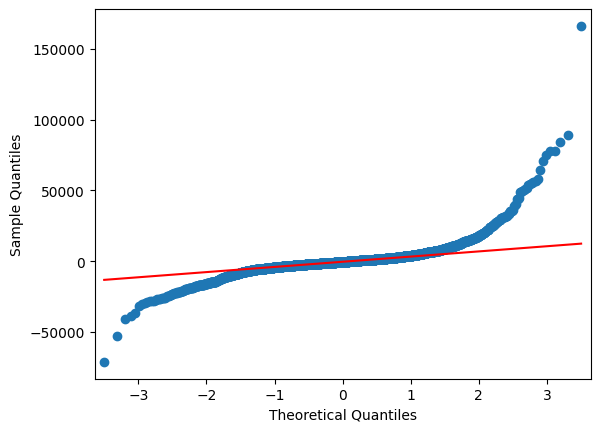

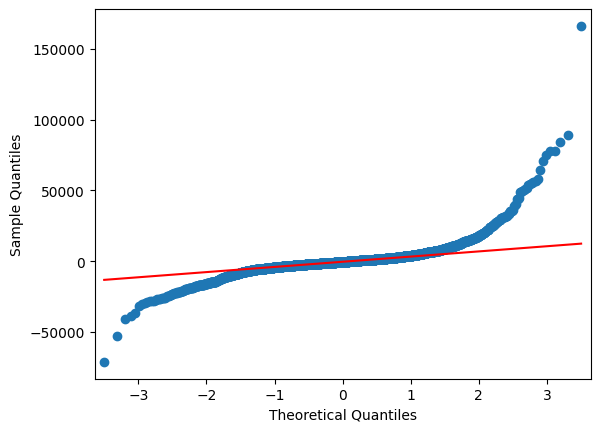

In [96]:
# 잔차의 정규성
qqplot(reg_result.resid, line = "q")



*   잔차의 값으로 만든 그래프(파란색 점)는 정규 분포 직선(빨간 직선)의 값을 따르는 경향이 있다.



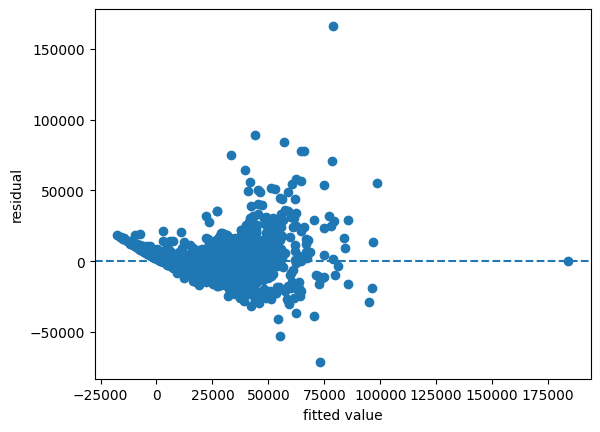

In [97]:
# 잔차의 등분산성 확인
plt.scatter(reg_result.fittedvalues, reg_result.resid)

plt.xlabel("fitted value")
plt.ylabel("residual")
plt.axhline(y = 0, linestyle = "--")



*   y=0을 기준으로 Random하게 산포되어 있으므로 등분산성을 만족



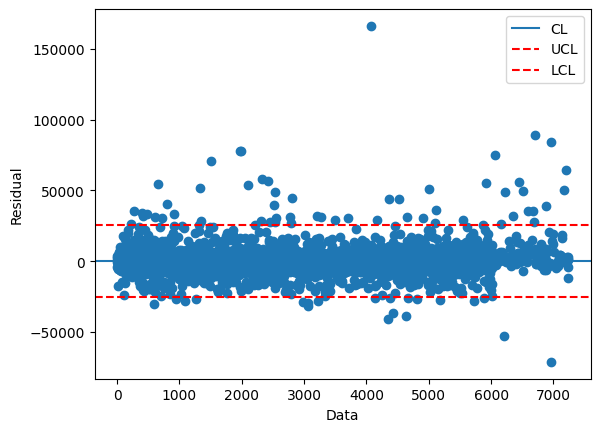

In [98]:
# 잔차의 독립성 확인
plt.scatter(df_train_x.index, reg_result.resid)
plt.xlabel("Data")  ;  plt.ylabel("Residual")
plt.axhline(y=0,linestyle="-", label='CL')
plt.axhline(y=3*np.std(reg_result.resid),linestyle="--",color="red",label='UCL' )
plt.axhline(y=-3*np.std(reg_result.resid),linestyle="dashed",color="red",label='LCL')
plt.legend()



*   대부분의 잔차가 y=0을 기준으로 관리상하한을 벗어나지 않고 Random하게 산포되어 있기때문에 독립성을 만족



### predict & evaluation

In [99]:
df_train_x_sd.columns

Index(['Kilometers_Driven', 'Mileage', 'Engine', 'Power', 'Seats',
       'Owner_Type_id', 'Age', 'Location_Ahmedabad', 'Location_Bangalore',
       'Location_Chennai', 'Location_Coimbatore', 'Location_Delhi',
       'Location_Hyderabad', 'Location_Jaipur', 'Location_Kochi',
       'Location_Kolkata', 'Location_Mumbai', 'Location_Pune', 'Fuel_Type_CNG',
       'Fuel_Type_Diesel', 'Fuel_Type_Electric', 'Fuel_Type_LPG',
       'Fuel_Type_Petrol', 'Transmission_Automatic', 'Transmission_Manual',
       'Brand_Ambassador', 'Brand_Audi', 'Brand_BMW', 'Brand_Bentley',
       'Brand_Chevrolet', 'Brand_Datsun', 'Brand_Fiat', 'Brand_Force',
       'Brand_Ford', 'Brand_Hindustan', 'Brand_Honda', 'Brand_Hyundai',
       'Brand_ISUZU', 'Brand_Jaguar', 'Brand_Jeep', 'Brand_Lamborghini',
       'Brand_Land', 'Brand_Mahindra', 'Brand_Maruti', 'Brand_Mercedes-Benz',
       'Brand_Mini', 'Brand_Mitsubishi', 'Brand_Nissan', 'Brand_OpelCorsa',
       'Brand_Porsche', 'Brand_Renault', 'Brand_Skoda', 'Bran

In [100]:
# "Price~ C(Location) + C(Brand) + C(Fuel_Type) + Kilometers_Driven + Power + Seats +  Age"
## 선정한 feature들을 바탕으로 sklearn의 LinearRegression() 이용하여 predict
# test data 성능 확인
df_train_x_selected= df_train_x_sd.drop(columns = ['Transmission_Automatic', 'Transmission_Manual', "Mileage", "Owner_Type_id", "Engine"])
df_test_x_selected = df_test_x_sd.drop(columns = ['Transmission_Automatic', 'Transmission_Manual', "Mileage", "Owner_Type_id", "Engine"])
df_train_selected = df_train_rg.drop(columns = ["Transmission", "Mileage", "Owner_Type_id", "Engine", "Brand_Country", "Brand_level"])
df_test_selected = df_test_rg.drop(columns = ["Transmission", "Mileage", "Owner_Type_id", "Engine", "Brand_Country", "Brand_level"])


# sklearn LinearRegrssion 적합
lr_final = LinearRegression()
lr_final.fit(df_train_x_selected, df_train_y)
test_r2 = lr.score(df_test_x_selected, df_test_y)

train_pred = reg_result.predict(df_train_rg)
train_r2 = r2_score(df_train_y, train_pred)

print("train data의 결정계수:", train_r2)
print("test data의 결정계수:", test_r2)
print()
print("train data의 수정결정계수:", 1-((1-train_r2)*((len(df_train_selected)-1)/((len(df_train_selected)-len(df_train_selected.columns)-1)-1))))
print("test data의 수정결정계수:", 1-((1-test_r2)*((len(df_test_selected)-1)/((len(df_test_selected)-len(df_train_selected.columns)-1)-1))))

KeyError: "['Brand_Country', 'Brand_level'] not found in axis"

- train과 test data의 결정계수 차이는 약 0.05
- 위 회귀식이 데이터를 약 76퍼센트 정도 설명한다고 할 수 있음

In [ ]:
# 표준화 회귀계수 구하기

df_train_rg_scaled = pd.concat([df_train_y, df_train_x_reg], axis=1)  # y와 scaled X 합치기

reg_model_final_scaled = smf.ols(formula = "Price~ C(Location) + C(Brand) + C(Fuel_Type) +\
 Kilometers_Driven + Power + Seats +  Age", data = df_train_rg_scaled)
reg_result_scaled = reg_model_final_scaled.fit()

print(reg_result_scaled.summary())

- 표준화 회귀계수
    - 유의한 변수들을 표준화 회귀계수의 절대값 순서로 정렬
    - 숫자형 변수 중에서는 Power, Seats, Kilometers_Driven, Age 순서로 중요하다.

## Decision tree

### fit & train

In [101]:
# 데이터 구성:Series, DataFrame
import pandas as pd
# 데이터 시각화
import matplotlib.pyplot as plt
import matplotlib
# export_graphviz: 나무 구조 생성 및 저장
from sklearn.tree import export_graphviz
# graphviz : 나무 구조 시각화  (.dot 확장자 파일 불러오기 등)
import graphviz
# 예측/회귀 Decision Tree
from sklearn.tree import DecisionTreeRegressor
# 최적 모델, 파라미터 탐색
from sklearn.model_selection import GridSearchCV

In [102]:
tree_uncustomized = DecisionTreeRegressor()
tree_uncustomized.fit (df_train_x_rd, df_train_y)
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(tree_uncustomized.score(df_train_x_rd, df_train_y)))
# test 데이터 설명력
print("Score on test set: {:.3f}".format(tree_uncustomized.score(df_test_x_rd, df_test_y)))

Score on training set: 1.000
Score on test set: 0.747




*   모델 설명력은 train 100%, test 77.8%로 모델은 train 데이터에 과적합 상태


In [103]:
tree_uncustomized.get_params()

{'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'random_state': None,
 'splitter': 'best'}

### 최소 잎사귀 노드(MIN_SAMPLES_LEAF)

In [104]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = [ ]
# min_samples_leaf: 잎사귀 최소 자료 수
para_leaf = [n_leaf for n_leaf in range(1,20)]

for v_min_samples_leaf in para_leaf:
    tree = DecisionTreeRegressor(min_samples_leaf=v_min_samples_leaf)
    tree.fit(df_train_x_rd, df_train_y)
    train_score.append(tree.score(df_train_x_rd, df_train_y))
    test_score.append(tree.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_leaf = pd.DataFrame()
df_score_leaf["MinSamplesLeaf"] = para_leaf
df_score_leaf["TrainScore"] = train_score
df_score_leaf["TestScore"] = test_score

In [105]:
# 모델 설명력 확인
df_score_leaf.round(3)

,MinSamplesLeaf,TrainScore,TestScore
0,1,1.000,0.778
1,2,0.972,0.762
2,3,0.951,0.749
3,4,0.921,0.816
4,5,0.911,0.836
5,6,0.901,0.825
6,7,0.892,0.791
7,8,0.884,0.794
8,9,0.880,0.787
9,10,0.873,0.803


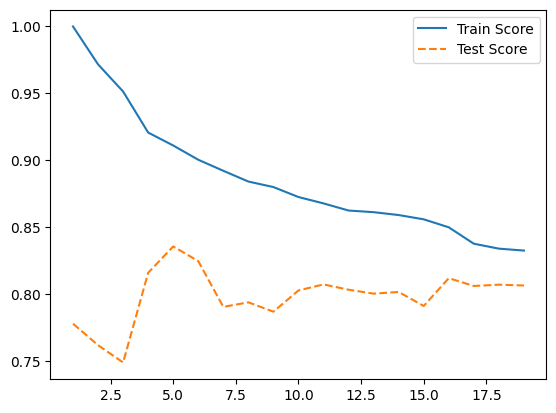

In [106]:
plt.plot(para_leaf, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_leaf, test_score, linestyle = "--", label = "Test Score")
plt.legend()

*  min_samples_leaf 값: 5
*  TestScore와 TrainScore 수치가 둘 다 가장 높은 5 선택

### 최대 깊이(MAX_DEPTH)

In [107]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# max_depth: 최대 깊이 변경
para_depth = [depth for depth in range(1, 20)]

for v_max_depth in para_depth:
    tree = DecisionTreeRegressor(min_samples_leaf=5, max_depth = v_max_depth)
    tree.fit(df_train_x_rd, df_train_y)
    train_score.append(tree.score(df_train_x_rd, df_train_y))
    test_score.append(tree.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_score_depth = pd.DataFrame()
df_score_depth["Depth"] = para_depth
df_score_depth["TrainScore"] = train_score
df_score_depth["TestScore"] = test_score

In [108]:
#  모델 설명력 확인
df_score_depth.round(3)

,Depth,TrainScore,TestScore
0,1,0.486,0.488
1,2,0.605,0.613
2,3,0.723,0.727
3,4,0.783,0.760
4,5,0.830,0.803
5,6,0.861,0.809
6,7,0.877,0.824
7,8,0.891,0.828
8,9,0.901,0.834
9,10,0.906,0.838


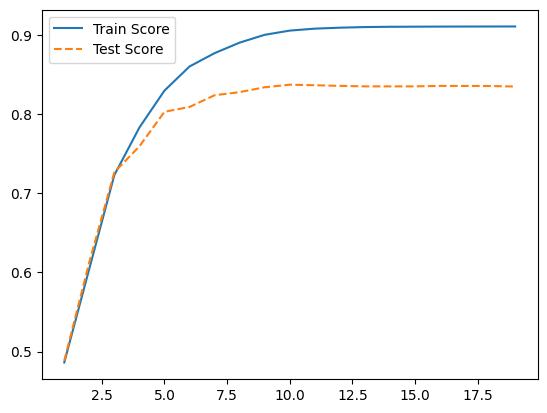

In [109]:
# 모델 설명력 그래프 확인
plt.plot(para_depth, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_depth, test_score, linestyle = "--", label = "Test Score")
plt.legend()

*  max_depth 값: 9
*  test 정확도와 train 정확도가 높아질시 과적합이 될 수 있음을 고려하여 9 선택

### 분리 노드의 최소 자료수(MIN_SAMPLES_SPLIT)

In [110]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# min_samples_split: 분리 노드의 최소 자료 수
para_split = [n_split * 2 for n_split in range(1, 50)]

for v_min_samples_split in para_split:
    tree = DecisionTreeRegressor(max_depth=9, min_samples_leaf=5
                                 , min_samples_split=v_min_samples_split )
    tree.fit(df_train_x_rd, df_train_y)
    train_score.append(tree.score(df_train_x_rd, df_train_y))
    test_score.append(tree.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_split = pd.DataFrame()
df_score_split["MinSamplesSplit"] = para_split
df_score_split["TrainScore"] = train_score
df_score_split["TestScore"] = test_score

In [111]:
df_score_split.round(3)

,MinSamplesSplit,TrainScore,TestScore
0,2,0.901,0.834
1,4,0.901,0.834
2,6,0.901,0.834
3,8,0.901,0.834
4,10,0.901,0.834
5,12,0.898,0.832
6,14,0.898,0.832
7,16,0.897,0.832
8,18,0.895,0.833
9,20,0.892,0.834


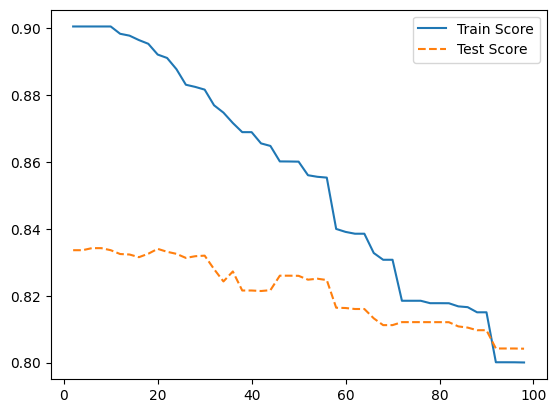

In [112]:
plt.plot(para_split, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_split, test_score, linestyle = "--", label = "Test Score")
plt.legend()

*  min_samples_split 값: 20 선택
*  train과 test의 정확도 및 일반화 성능 고려

### predict & evaluation

In [113]:
v_feature_name = df_train_x_rd.columns
tree_final = DecisionTreeRegressor(min_samples_leaf = 5, min_samples_split = 20, max_depth = 9)
tree_final.fit(df_train_x_rd, df_train_y)
tree_final.get_params()

{'ccp_alpha': 0.0,
 'criterion': 'squared_error',
 'max_depth': 9,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 5,
 'min_samples_split': 20,
 'min_weight_fraction_leaf': 0.0,
 'random_state': None,
 'splitter': 'best'}

In [114]:
tree_final.score(df_train_x_rd, df_train_y)

0.8922000525780369

In [115]:
tree_final.score(df_test_x_rd, df_test_y)

0.834044303183361

*  최대 깊이(max_depth) 9,  
분리 노드의 최소 자료 수(min_samples_split) 20,  
잎사귀 노드의 최소 자료 수(min_samples_leaf) 5 일 때,  
 **설명력이 83.4%**

### feature importance

In [116]:
# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final.feature_importances_

# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
3,Power,0.714
6,Age,0.185
2,Engine,0.036
1,Mileage,0.020
12,Location_Hyderabad,0.012
0,Kilometers_Driven,0.008
24,Transmission_Manual,0.007
44,Brand_Mercedes-Benz,0.006
45,Brand_Mini,0.002
4,Seats,0.002


Text(0, 0.5, '변수')

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 50836 (\N{HANGUL SYLLABLE YO}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 46020 (\N{HANGUL SYLLABLE DO}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 49688 (\N{HANGUL SY

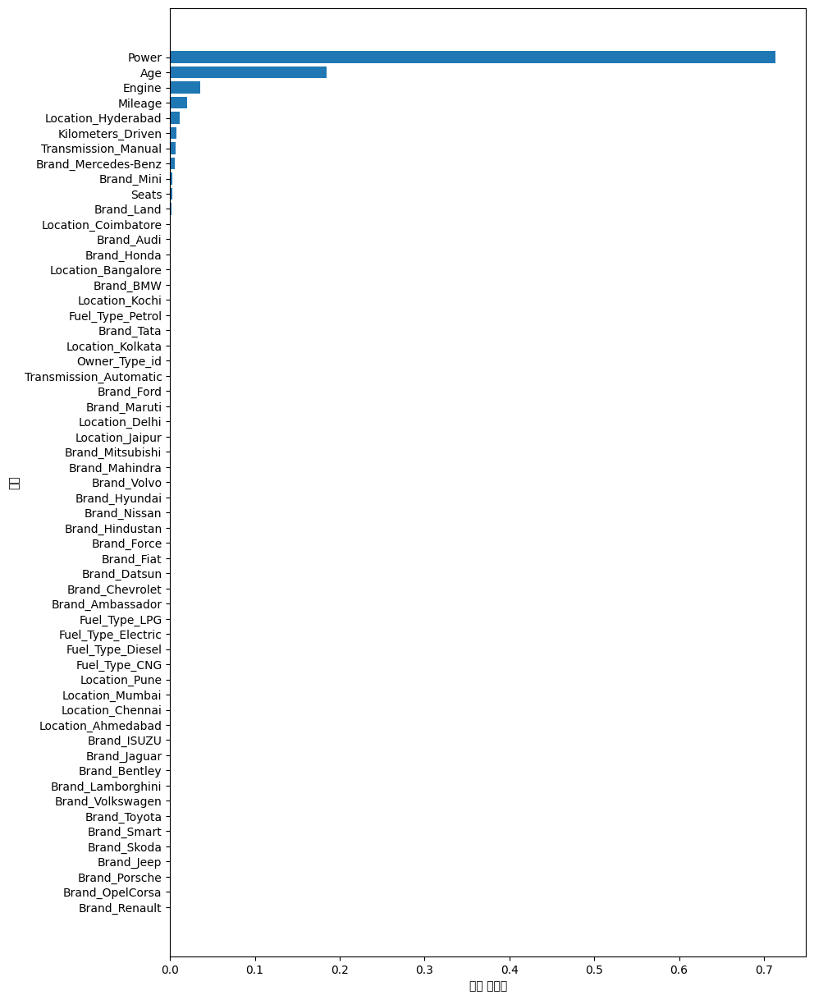

In [117]:
# 설명변수 중요도 그래프
# 중요도가 높은 변수를 상위에 그림
df_importance.sort_values("Importance", ascending=True, inplace = True)
fig, axes = plt.subplots(figsize=(10,15))

coordinates = range(len(df_importance))

plt.barh(y = coordinates, width = df_importance["Importance"])
plt.yticks(coordinates, df_importance["Feature"])
plt.xlabel("변수 중요도")
plt.ylabel("변수")

* 설명변수 중요도  
Power > Age > Engine > Mileage > Location_Hyderabad > Kilometers_Driven  
 순으로 영향력이 크다

## Randomforest

### fit & train

In [118]:
# df_train_x_rd, df_test_x_rd, df_train_y, df_test_y

In [119]:
rf_uncustomized = RandomForestRegressor(random_state=1234)
rf_uncustomized.fit(df_train_x_rd, df_train_y)
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(rf_uncustomized.score(df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(rf_uncustomized.score(df_test_x_rd, df_test_y)))

Score on training set: 0.980
Score on test set: 0.861


*  모델 설명력은 train 98%, test 86.1%로 모델은 train 데이터에 과적합 상태



### 트리 수(N_ESTIMATORS)

In [120]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# n_estimatos: 트리 수 변경: 1~100
para_n_tree = [n_tree * 10 for n_tree in range(1, 15)] #10,20,...,140

for v_n_estimators in para_n_tree:
    rf = RandomForestRegressor(n_estimators = v_n_estimators, random_state = 1234)
    rf.fit(df_train_x_rd, df_train_y)
    train_score.append(rf.score(df_train_x_rd, df_train_y))
    test_score.append(rf.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_n = pd.DataFrame()
df_score_n["n_estimators"] = para_n_tree
df_score_n["TrainScore"] = train_score
df_score_n["TestScore"] = test_score

In [121]:
df_score_n.round(3)

,n_estimators,TrainScore,TestScore
0,10,0.963,0.839
1,20,0.974,0.854
2,30,0.977,0.851
3,40,0.979,0.857
4,50,0.980,0.860
5,60,0.980,0.860
6,70,0.980,0.861
7,80,0.979,0.861
8,90,0.980,0.860
9,100,0.980,0.861


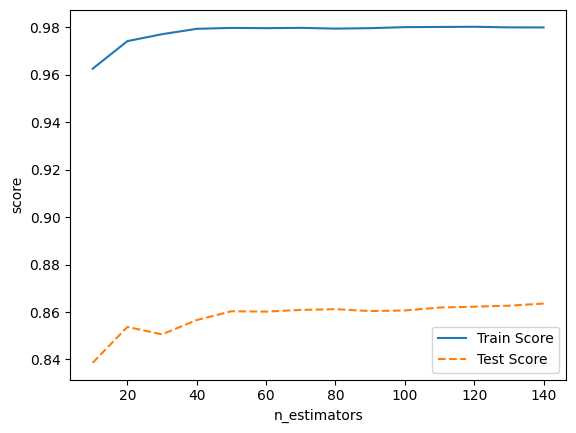

In [122]:
# 모델 설명력 그래프 확인
plt.plot(para_n_tree, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_n_tree, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("n_estimators")
plt.legend()



*   n_estimators 값: 100
*   90부터 Train Score의 값은 상승하지 않음.
*   최대 트리 수에 따른 영향을 배제하고 다른 파라미터의 영향을 확인하기 위해 100으로 선택



### 최소 잎사귀 노드(MIN_SAMPLES_LEAF)

In [123]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# min_samples_leaf: 잎사귀 최소 자료 수
para_leaf = [n_leaf for n_leaf in range(1, 21)] #1,2,...,20

for v_min_samples_leaf in para_leaf:
    rf = RandomForestRegressor(random_state=1234, n_estimators = 100,
                                min_samples_leaf = v_min_samples_leaf)
    rf.fit(df_train_x_rd, df_train_y)
    train_score.append(rf.score(df_train_x_rd, df_train_y))
    test_score.append(rf.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_score_leaf = pd.DataFrame()
df_score_leaf["MinSamplesLeaf"] = para_leaf
df_score_leaf["TrainScore"] = train_score
df_score_leaf["TestScore"] = test_score

df_score_leaf.round(3)

,MinSamplesLeaf,TrainScore,TestScore
0,1,0.980,0.861
1,2,0.957,0.867
2,3,0.939,0.863
3,4,0.924,0.856
4,5,0.912,0.849
5,6,0.902,0.843
6,7,0.893,0.836
7,8,0.886,0.834
8,9,0.881,0.833
9,10,0.876,0.831


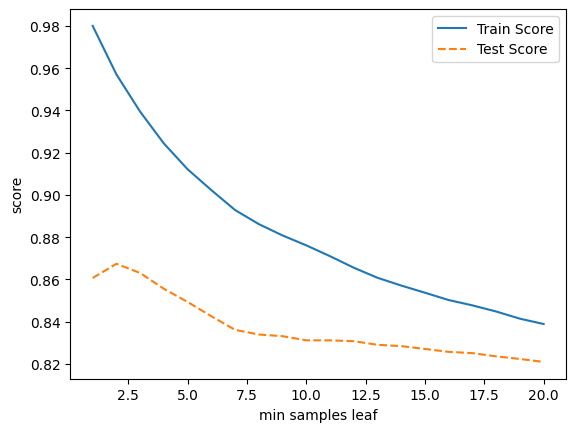

In [124]:
# 모델 설명력 그래프 확인
plt.plot(para_leaf, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_leaf, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("min samples leaf")
plt.legend()

*   min_samples_leaf 값: 10

### 분리 노드의 최소 자료수(MIN_SAMPLES_SPLIT)

In [125]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# min_samples_split: 분할하기 위한 노드의 최소 자료 수
para_split = [n_split * 2for n_split in range(2, 21)] # 4,6,8,...,40

for v_min_samples_split in para_split:
    rf = RandomForestRegressor(random_state=1234, n_estimators = 100, min_samples_leaf = 10,
                               min_samples_split = v_min_samples_split)
    rf.fit(df_train_x_rd, df_train_y)
    train_score.append(rf.score(df_train_x_rd, df_train_y))
    test_score.append(rf.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_score_split = pd.DataFrame()
df_score_split["MinSamplesSplit"] = para_split
df_score_split["TrainScore"] = train_score
df_score_split["TestScore"] = test_score
df_score_split.round(3)

,MinSamplesSplit,TrainScore,TestScore
0,4,0.876,0.831
1,6,0.876,0.831
2,8,0.876,0.831
3,10,0.876,0.831
4,12,0.876,0.831
5,14,0.876,0.831
6,16,0.876,0.831
7,18,0.876,0.831
8,20,0.876,0.831
9,22,0.875,0.832


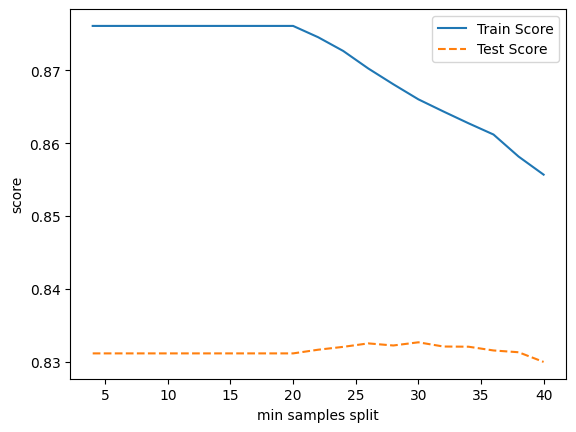

In [126]:
# 모델 설명력 그래프 확인
plt.plot(para_split, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_split, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("min samples split")
plt.legend()



*   min_samples_split 값: 20
*   분리 노드 최소 자료 수 증가에 따라 모델의 설명력이 감소하기 때문에 두 데이터의 성능 변화를 고려



### 최대 깊이(MAX_DEPTH)

In [127]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# max_depth: 최대 깊이 변경
para_depth = [depth for depth in range(1, 11)]

for v_max_depth in para_depth:
    rf = RandomForestRegressor(random_state=1234, n_estimators = 100,
                               min_samples_leaf = 10, min_samples_split=20,
                               max_depth = v_max_depth)
    rf.fit(df_train_x_rd, df_train_y)
    train_score.append(rf.score(df_train_x_rd, df_train_y))
    test_score.append(rf.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_score_depth = pd.DataFrame()
df_score_depth["Depth"] = para_depth
df_score_depth["TrainScore"] = train_score
df_score_depth["TestScore"] = test_score
df_score_depth.round(3)

,Depth,TrainScore,TestScore
0,1,0.487,0.489
1,2,0.659,0.657
2,3,0.761,0.755
3,4,0.815,0.789
4,5,0.845,0.809
5,6,0.861,0.821
6,7,0.868,0.826
7,8,0.872,0.829
8,9,0.875,0.830
9,10,0.876,0.831


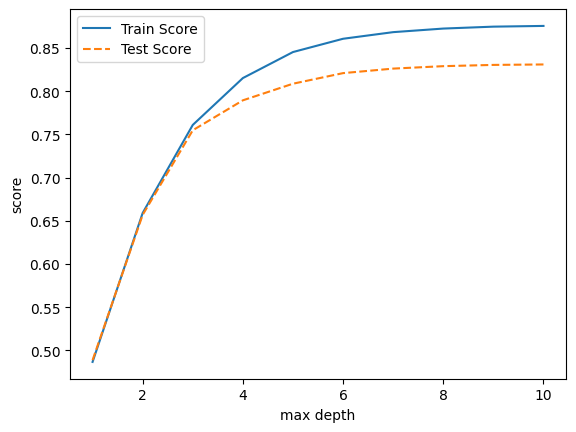

In [128]:
# 모델 설명력 그래프 확인
plt.plot(para_depth, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_depth, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("max depth")
plt.legend()

*   max_depth 값: 10
*   깊이 증가에 따라 모델의 설명력은 증가

### 최종모델(random_state X)

In [129]:
rf_final = RandomForestRegressor(n_estimators = 100,
                               min_samples_leaf = 10,min_samples_split=20,
                               max_depth = 10)
rf_final.fit(df_train_x_rd, df_train_y)
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(rf_final.score(df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(rf_final.score(df_test_x_rd, df_test_y)))

Score on training set: 0.874
Score on test set: 0.831




*   n_estimators(트리 수) 100,  
최대 깊이(max_depth) 10,  
분리 노드의 최소 자료 수(min_samples_split) 20,  
잎사귀 노드의 최소 자료 수(min_samples_leaf) 10 일 때,  
 **설명력이 83.1%**



### predict & evaluation

### grid search

## Gradient Boosting

In [130]:
# 예측/회귀 Gradient Boosting
from sklearn.ensemble import GradientBoostingRegressor


### fit & train

In [131]:
# 모델 생성: GradientBoostingRegressor
gb_uncustomized = GradientBoostingRegressor()
gb_uncustomized.fit(df_train_x_rd, df_train_y)
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(gb_uncustomized.score (df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(gb_uncustomized.score (df_test_x_rd, df_test_y)))

#default parameter : n_estimators = 100, learning rate = 0.1, min_samples_split = 2, min_samples_leaf = 1, max_depth = 3

Score on training set: 0.925
Score on test set: 0.856




*   모델 설명력은 train 92.5%, test 85.6%로 모델은 train 데이터에 과적합 상태



### 트리 수(N_ESTIMATORS)

In [132]:
#파라미터지정 (n_estimators)

#train 및 test 설명력 결과 저장
train_score = []; test_score = []
# n_estimators: 트리 수 변경(10~200)
para_n_tree = [n_tree * 10 for n_tree in range(1,20)]

for v_n_estimators in para_n_tree:
    gb = GradientBoostingRegressor(n_estimators = v_n_estimators)
    gb.fit(df_train_x_rd, df_train_y)
    train_score.append(gb.score(df_train_x_rd, df_train_y))
    test_score.append(gb.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_n = pd.DataFrame()
df_score_n["Estimators"] = para_n_tree
df_score_n["TrainScore"] = train_score
df_score_n["TestScore"] = test_score

df_score_n.round(3)

,Estimators,TrainScore,TestScore
0,10,0.678,0.666
1,20,0.818,0.798
2,30,0.866,0.830
3,40,0.885,0.839
4,50,0.896,0.844
5,60,0.905,0.846
6,70,0.911,0.851
7,80,0.915,0.852
8,90,0.920,0.853
9,100,0.925,0.857


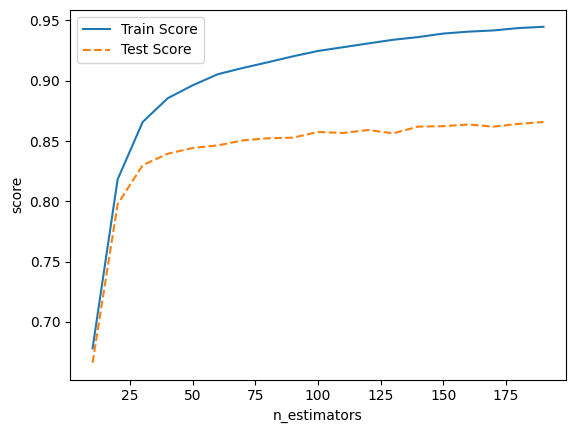

In [133]:
# 모델 설명력 그래프 확인
plt.plot(para_n_tree, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_n_tree, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("n_estimators")
plt.legend()

*  n_estimators 값 = 130
*  Test 데이터의 성능 변화를 고려

###  최소 잎사귀 노드(MIN_SAMPLES_LEAF)

In [134]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# min_samples_leaf: 잎사귀 최소 자료 수
para_leaf = [n_leaf for n_leaf in range(1, 21)]

for v_min_samples_leaf in para_leaf:
    gb = GradientBoostingRegressor(n_estimators = 130,
                                   min_samples_leaf = v_min_samples_leaf)
    gb.fit(df_train_x_rd, df_train_y)
    train_score.append(gb.score(df_train_x_rd, df_train_y))
    test_score.append(gb.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_leaf = pd.DataFrame()
df_score_leaf["MinSamplesLeaf"] = para_leaf
df_score_leaf["TrainScore"] = train_score
df_score_leaf["TestScore"] = test_score

df_score_leaf.round(3)

,MinSamplesLeaf,TrainScore,TestScore
0,1,0.934,0.858
1,2,0.930,0.854
2,3,0.928,0.859
3,4,0.925,0.866
4,5,0.921,0.862
5,6,0.919,0.862
6,7,0.918,0.864
7,8,0.916,0.856
8,9,0.914,0.864
9,10,0.912,0.861


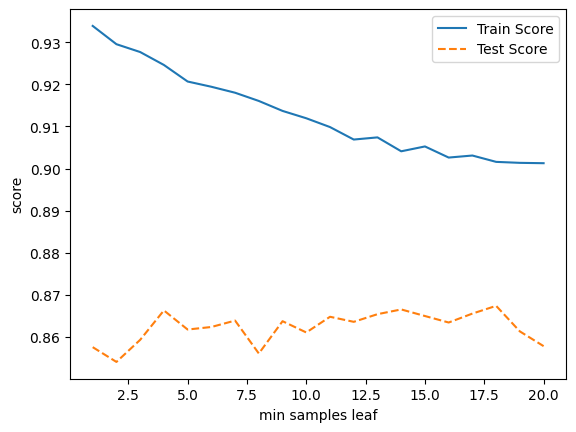

In [135]:
# 모델 설명력 그래프 확인
plt.plot(para_leaf, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_leaf, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("min samples leaf")
plt.legend()

*  min_samples_leaf 값 = 14
*  잎사귀 노드의 최소 자료 수 증가에 따라 모델의 설명력이 감소하기에 성능 변화를 고려하여 선택

### 분리 노드의 최소 자료 수(MIN_SAMPLES_SPLIT)

In [136]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# min_samples_split: 분할하기 위한 노드의 최소 자료 수
para_split = [n_split for n_split in range(2, 21)]

for v_min_samples_split in para_split:
    gb = GradientBoostingRegressor(n_estimators = 130, min_samples_leaf = 14,
                                   min_samples_split = v_min_samples_split)
    gb.fit(df_train_x_rd, df_train_y)
    train_score.append(gb.score(df_train_x_rd, df_train_y))
    test_score.append(gb.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_split = pd.DataFrame()
df_score_split["MinSamplesSplit"] = para_split
df_score_split["TrainScore"] = train_score
df_score_split["TestScore"] = test_score

df_score_split.round(3)

,MinSamplesSplit,TrainScore,TestScore
0,2,0.904,0.867
1,3,0.904,0.867
2,4,0.904,0.867
3,5,0.904,0.867
4,6,0.904,0.867
5,7,0.904,0.867
6,8,0.904,0.867
7,9,0.904,0.867
8,10,0.904,0.867
9,11,0.904,0.867


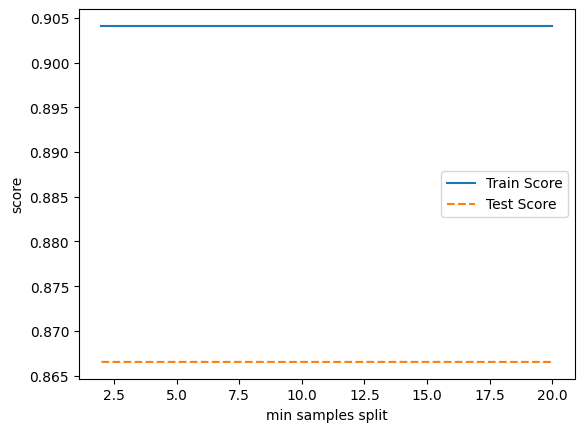

In [137]:
# 모델 설명력 그래프 확인
plt.plot(para_split, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_split, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("min samples split")
plt.legend()

*  min_samples_split 값 지정 X
*  해당 파라미터는 값에 변화가 없기에 모델에 영향을 주지 않는 듯 하여 지정하지 않음.
*  default값 2로 자동 설정.

###  최대 깊이(MAX_DEPTH)

In [138]:
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# max_depth: 최대 깊이 변경
para_depth = [depth for depth in range(1, 11)]

for v_max_depth in para_depth:
    gb = GradientBoostingRegressor(n_estimators = 130, min_samples_leaf = 14,
                                    max_depth = v_max_depth)
    gb.fit(df_train_x_rd, df_train_y)
    train_score.append(gb.score(df_train_x_rd, df_train_y))
    test_score.append(gb.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_depth = pd.DataFrame()
df_score_depth["Depth"] = para_depth
df_score_depth["TrainScore"] = train_score
df_score_depth["TestScore"] = test_score

df_score_depth.round(3)

,Depth,TrainScore,TestScore
0,1,0.761,0.755
1,2,0.872,0.851
2,3,0.904,0.867
3,4,0.927,0.865
4,5,0.941,0.860
5,6,0.950,0.863
6,7,0.955,0.859
7,8,0.960,0.861
8,9,0.962,0.862
9,10,0.965,0.862


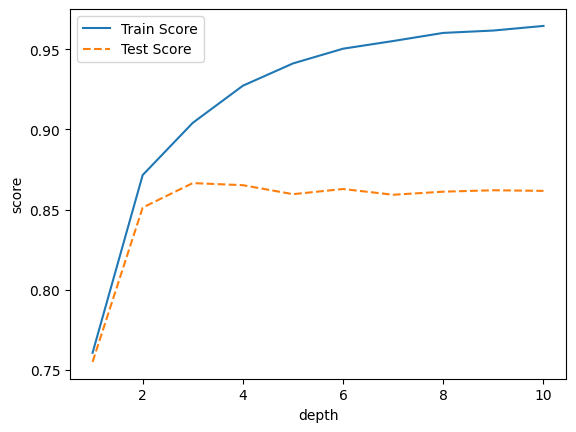

In [139]:
# 모델 설명력 그래프 확인
plt.plot(para_depth, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_depth, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("depth")
plt.legend()

*  max_depth 값 = 3 (default 값)  
*  깊이 증가에 따라 모델의 설명력은 증가하며 test 데이터의 성능 변화를 고려

### 학습률(LEARNING_RATE)

In [140]:
# learning_rate: 학습률 변경에 따른 모델 성능
# train 및 test 설명력 결과 저장
train_score = []; test_score = []
# learning rate: 학습률 변경 0.1 ~ 0.3
para_lr = [lr * 0.02 for lr in range(5, 16)]

for v_learning_rate in para_lr:
    gb = GradientBoostingRegressor(n_estimators = 130, min_samples_leaf = 14,
                                   max_depth = 3 ,learning_rate = v_learning_rate)
    gb.fit(df_train_x_rd, df_train_y)
    train_score.append(gb.score(df_train_x_rd, df_train_y))
    test_score.append(gb.score(df_test_x_rd, df_test_y))

# 결과 저장
df_score_lr = pd.DataFrame()
df_score_lr["LearningRate"] = para_lr
df_score_lr["TrainScore"] = train_score
df_score_lr["TestScore"] = test_score

df_score_lr.round(3)

,LearningRate,TrainScore,TestScore
0,0.10,0.904,0.867
1,0.12,0.909,0.864
2,0.14,0.915,0.868
3,0.16,0.919,0.871
4,0.18,0.923,0.873
5,0.20,0.927,0.869
6,0.22,0.931,0.871
7,0.24,0.933,0.872
8,0.26,0.937,0.872
9,0.28,0.938,0.868


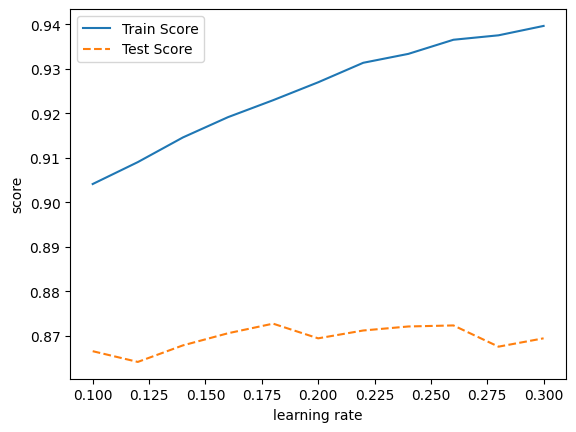

In [141]:
# 모델 설명력 그래프 확인
plt.plot(para_lr, train_score, linestyle = "-", label = "Train Score")
plt.plot(para_lr, test_score, linestyle = "--", label = "Test Score")
plt.ylabel("score"); plt.xlabel("learning rate")
plt.legend()

*  learning_rate 값 = 0.1
*  0.1보다 높아지면 데이터의 성능은 급격하게 저하됨
*  0.1 ~ 0.2 사이 세밀한 값으로 성능 확인 필요

###  최종모델


In [142]:
# 최종모델 선택
gb_final = GradientBoostingRegressor(n_estimators = 130, min_samples_leaf = 14,
                                     max_depth = 3, learning_rate = 0.1)
gb_final.fit(df_train_x_rd, df_train_y)
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(gb_final.score(df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(gb_final.score(df_test_x_rd, df_test_y)))

Score on training set: 0.904
Score on test set: 0.867



*   n_estimators(트리 수) 130,  
최대 깊이(max_depth) 3,  
분리 노드의 최소 자료 수(min_samples_split) 2,  
잎사귀 노드의 최소 자료 수(min_samples_leaf) 14 일 때,  
 **설명력이 86.7%**



### feature importance

In [144]:
# feature_importances_: 설명변수의 중요도
v_feature_name = df_train_x_rd.columns

# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = gb_final.feature_importances_
# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance10 = df_importance.round(3).head(10)
df_importance10

,Feature,Importance
3,Power,0.689
6,Age,0.169
0,Kilometers_Driven,0.030
2,Engine,0.029
41,Brand_Land,0.017
44,Brand_Mercedes-Benz,0.014
1,Mileage,0.012
23,Transmission_Automatic,0.011
22,Fuel_Type_Petrol,0.005
24,Transmission_Manual,0.004


Text(0, 0.5, '변수')

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 50836 (\N{HANGUL SYLLABLE YO}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 46020 (\N{HANGUL SYLLABLE DO}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning:

Glyph 49688 (\N{HANGUL SY

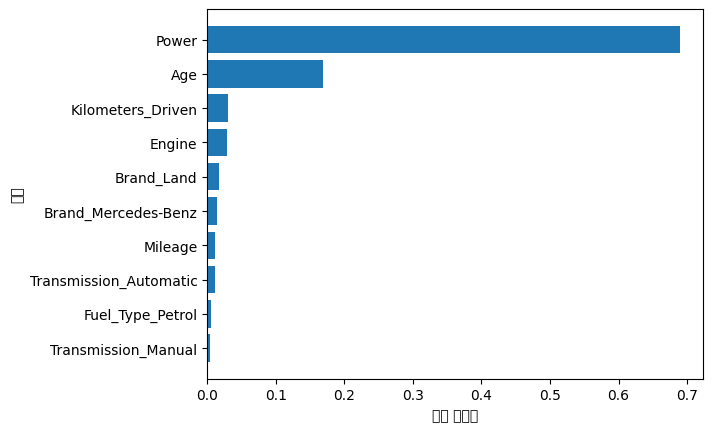

In [145]:
# 중요도가 높은 변수 상위10개 그래프
df_importance10.sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance10))
plt.barh(y = coordinates, width = df_importance10["Importance"])
plt.yticks(coordinates, df_importance10["Feature"])
plt.xlabel("변수 중요도")
plt.ylabel("변수")

### predict & evaluation

In [143]:
#예측값
test_gb_pred =gb_final.predict(df_test_x_rd)

* 설명변수 중요도  
Power > Age > Kilometers_Driven > Engine > Brand_Land  
 순으로 영향력이 크다

### grid search

In [146]:
from sklearn.model_selection import GridSearchCV

In [147]:
# GridSearchCV를 이용한 최적 parameter 찾기
estimator = GradientBoostingRegressor()
param_grid = {"criterion": ["mse", "friedman_mse", "mae"], "max_features": [1.0, "sqrt", "log2"],
              "learning_rate": para_lr, "max_depth": para_depth, "min_samples_leaf": para_leaf}

grid_gb = GridSearchCV(estimator, param_grid, scoring="r2", n_jobs = -1)
grid_gb.fit(df_train_x_rd, df_train_y)

print("best estimator model: \n{}".format(grid_gb.best_estimator_))
print("\nbest parameter: \n{}".format(grid_gb.best_params_))
print("\nbest score: \n{}".format(grid_gb.best_score_.round(3)))

KeyboardInterrupt: 

In [ ]:
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(grid_gb.score(df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(grid_gb.score(df_test_x_rd, df_test_y)))

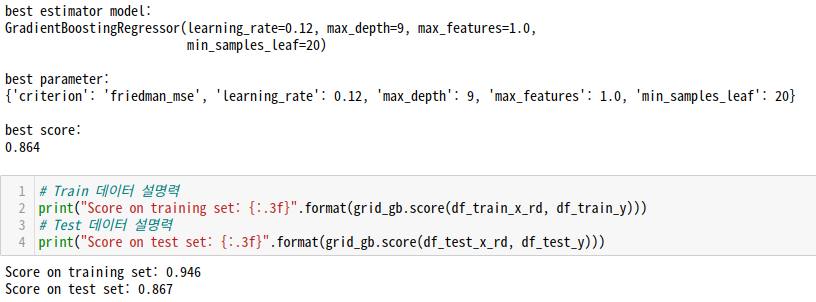

grid search 로 탐색한 최적 모델의 설명력은 0.867로 직접 파라미터를 선택한 모델과 설명력이 같다.


## XGBoost

In [149]:
from xgboost import XGBRegressor

### fit & train

In [150]:
xgb_uncustomized = XGBRegressor(random_state=1234)
xgb_uncustomized.fit(df_train_x_rd, df_train_y)
# Train 데이터 설명력
print("Score on training set: {:.3f}".format(xgb_uncustomized.score(df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(xgb_uncustomized.score(df_test_x_rd, df_test_y)))

Score on training set: 0.995
Score on test set: 0.855




*   모델 설명력은 train 99.5%, test 85.5%로 모델은 train 데이터에 과적합 상태



### 학습률(LEARNING_RATE)

In [151]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# learning_rate 학습률 변경
# para_lr = [lr * 0.1 for lr in range(1, 10)]
para_lr = [lr * 0.01 for lr in range(1, 10)]   # 민감하게 변화하면 0.02 간격으로 확인

for v_learning_rate in para_lr:
    xgb = XGBRegressor(random_state = 1234, learning_rate = v_learning_rate)
    xgb.fit(df_train_x_rd, df_train_y)
    train_accuracy.append(xgb.score(df_train_x_rd, df_train_y))
    test_accuracy.append(xgb.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_accuracy_lr = pd.DataFrame()
df_accuracy_lr["LearningRate"] = para_lr
df_accuracy_lr["TrainAccuracy"] = train_accuracy
df_accuracy_lr["TestAccuracy"] = test_accuracy

In [152]:
# LearningRate별 정확도
df_accuracy_lr.round(3)

,LearningRate,TrainAccuracy,TestAccuracy
0,0.01,0.757,0.702
1,0.02,0.903,0.822
2,0.03,0.941,0.845
3,0.04,0.956,0.843
4,0.05,0.961,0.846
5,0.06,0.966,0.846
6,0.07,0.969,0.851
7,0.08,0.972,0.849
8,0.09,0.975,0.847


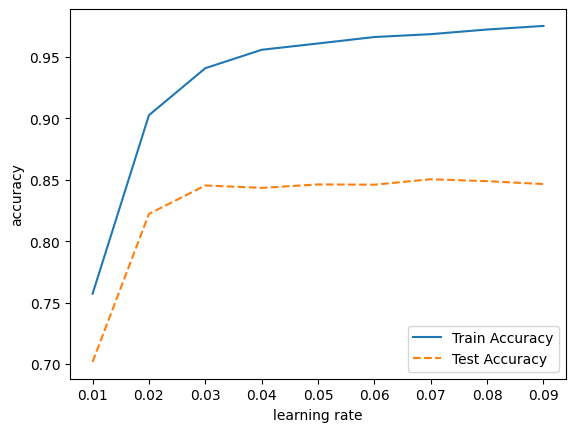

In [153]:
# LearningRate별 정확도 그래프 확인
plt.plot(para_lr, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_lr, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.ylabel("accuracy"); plt.xlabel("learning rate")
plt.legend()

*  learning_rate 값 = 0.04
*  학습률이 증가하면 train 모델의 정확도는 지속적으로 증가하나 test는 84% 수준에서 변동하지 않음

### 트리 수(N_ESTIMATORS)

In [154]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# n_estimatos: 트리 수 변경
para_n_tree = [n_tree * 10 for n_tree in range(1, 16)]

for v_n_estimators in para_n_tree:
    xgb = XGBRegressor(random_state=1234, learning_rate=0.04,
                       n_estimators = v_n_estimators)
    xgb.fit(df_train_x_rd, df_train_y)
    train_accuracy.append(xgb.score(df_train_x_rd, df_train_y))
    test_accuracy.append(xgb.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_accuracy_n = pd.DataFrame()
df_accuracy_n["Estimators"] = para_n_tree
df_accuracy_n["TrainAccuracy"] = train_accuracy
df_accuracy_n["TestAccuracy"] = test_accuracy

In [155]:
# 모델 설명력 확인
df_accuracy_n.round(3)

,Estimators,TrainAccuracy,TestAccuracy
0,10,0.469,0.438
1,20,0.694,0.646
2,30,0.809,0.748
3,40,0.870,0.798
4,50,0.903,0.822
5,60,0.923,0.835
6,70,0.937,0.841
7,80,0.946,0.844
8,90,0.952,0.844
9,100,0.956,0.843


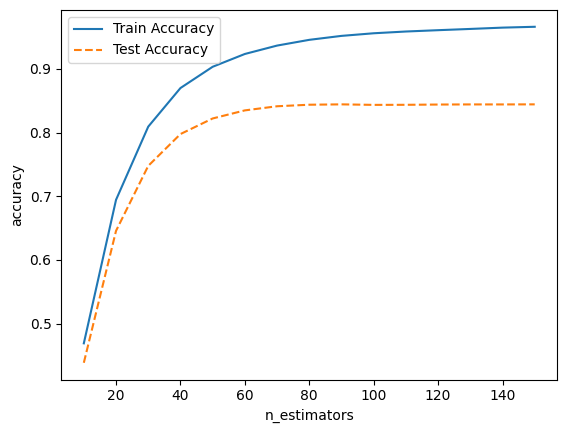

In [156]:
# 정확도를 그래프 확인
plt.plot(para_n_tree, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_n_tree, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.ylabel("accuracy"); plt.xlabel("n_estimators")
plt.legend()

*  n_estimators 값 = 120
*  트리 수 증가에 따라 모델 정확도 증가

### 최대 깊이(MAX_DEPTH)

In [157]:
# train 및 test 정확도 결과 저장용
train_accuracy = []; test_accuracy = []
# max_depth: 최대 깊이 변경. 1~10
para_depth = [depth for depth in range(1, 11)]

for v_max_depth in para_depth:
    xgb = XGBRegressor(max_depth = v_max_depth,
                            n_estimators=120, learning_rate=0.04, random_state=1234)
    xgb.fit(df_train_x_rd, df_train_y)
    train_accuracy.append(xgb.score(df_train_x_rd, df_train_y))
    test_accuracy.append(xgb.score(df_test_x_rd, df_test_y))

# 데이터 테이블로 저장
df_accuracy_depth = pd.DataFrame()
df_accuracy_depth["Depth"] = para_depth
df_accuracy_depth["TrainAccuracy"] = train_accuracy
df_accuracy_depth["TestAccuracy"] = test_accuracy

In [158]:
#  모델 설명력 확인
df_accuracy_depth.round(3)

,Depth,TrainAccuracy,TestAccuracy
0,1,0.699,0.693
1,2,0.834,0.806
2,3,0.886,0.841
3,4,0.920,0.842
4,5,0.945,0.843
5,6,0.961,0.844
6,7,0.974,0.845
7,8,0.984,0.841
8,9,0.991,0.832
9,10,0.994,0.826


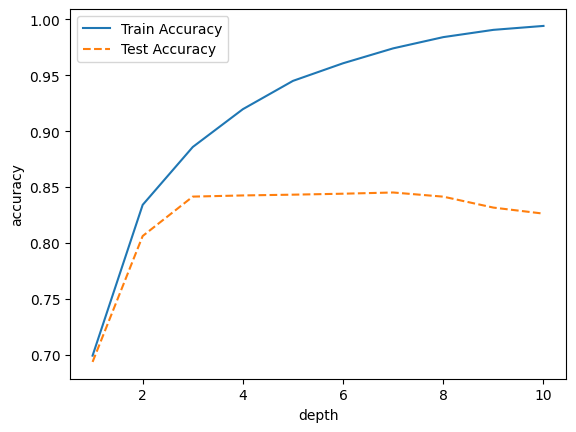

In [159]:
# 정확도를 그래프 확인
plt.plot(para_depth, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_depth, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.ylabel("accuracy"); plt.xlabel("depth")
plt.legend()

*  max_depth 값 = 3

### 최종모델

In [160]:
xgb_final = XGBRegressor(max_depth = 3, n_estimators=120, learning_rate=0.04)
xgb_final.fit(df_train_x_rd, df_train_y)

# 예측
y_pred = xgb_final.predict(df_test_x_rd)

# Train 데이터 설명력
print("Score on training set: {:.3f}".format(xgb_final.score(df_train_x_rd, df_train_y)))
# Test 데이터 설명력
print("Score on test set: {:.3f}".format(xgb_final.score(df_test_x_rd, df_test_y)))

Score on training set: 0.886
Score on test set: 0.841



*   n_estimators(트리 수) 120,  
최대 깊이(max_depth) 3,  
학습률(learning_rate) 0.04 일 때,  
 **설명력이 84.1%**



### feature importance

In [161]:
# 변수명
v_feature_name = df_train_x_rd.columns
# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance ["Feature"] = v_feature_name
df_importance ["Importance"] = xgb_final.feature_importances_
# df_feature_importance의 테이블을 중요도별로 정렬
df_importance .sort_values("Importance", ascending=False, inplace = True)
df_importance .round(3)

,Feature,Importance
3,Power,0.346
23,Transmission_Automatic,0.102
6,Age,0.093
22,Fuel_Type_Petrol,0.077
2,Engine,0.064
0,Kilometers_Driven,0.042
44,Brand_Mercedes-Benz,0.041
41,Brand_Land,0.039
26,Brand_Audi,0.027
19,Fuel_Type_Diesel,0.018


Text(0, 0.5, '설명변수')

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 49444 (\N{HANGUL SYLLABLE SEOL}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 47749 (\N{HANGUL SYLLABLE MYEONG}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 48320 (\N{HANGUL SYLLABLE BYEON}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 49688 (\N{HANGUL SYLLABLE SU}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 50836 (\N{HANGUL SYLLABLE YO}) missing from current font.

/usr/local/lib/python3.10/dist-packages/IPython/core/events.py:89: UserWarning:

Glyph 46020 (\N{HANGUL SYLLABLE 

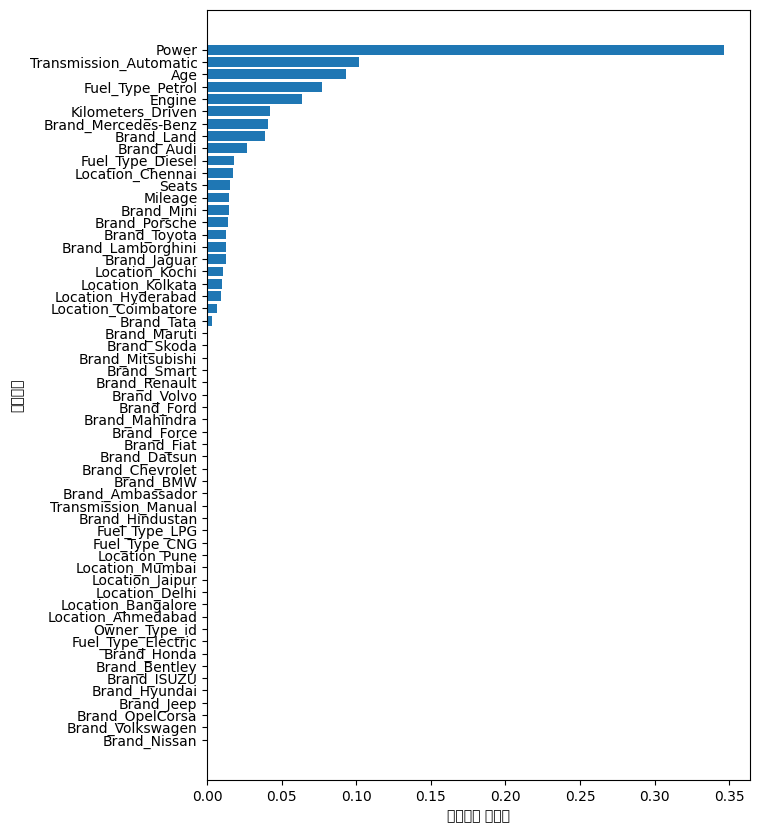

In [162]:
# 설명변수 중요도 그래프
# 중요도가 높은 변수를 상위에 그림
fig, ax = plt.subplots(figsize=(7, 10))

df_importance .sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance ))
plt.barh(y = coordinates, width = df_importance ["Importance"])
plt.yticks(coordinates, df_importance ["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

* 설명변수 중요도  
Power > Transmission_Automatic > Age > Fuel_Type_Petrol > Engine > Kilometers_Driven  
 순으로 영향력이 크다

### grid search

In [163]:

estimator = XGBRegressor(random_state=1234)
param_grid = {"learning_rate": para_lr, "max_depth": para_depth, "min_samples_leaf": para_leaf,
              'gamma' : [0,1,2,3]}

grid_xgb = GridSearchCV(estimator, param_grid, scoring="r2", n_jobs = -1)
grid_xgb.fit(df_train_x_rd, df_train_y)

print("best estimator model: \n{}".format(grid_xgb.best_estimator_))
print("\nbest parameter: \n{}".format(grid_xgb.best_params_))
print("\nbest score: \n{}".format(grid_xgb.best_score_.round(3)))

KeyboardInterrupt: 

# 결론

### important feature 선정

- test R2 score 및 best 5 features

| | Regression | Decision Tree | Random Forest | Gradient Boosting | XG Boost |
|---|---|---|---|---|---|
|R2|0.715|0.834|0.833|0.867|0.841|
|No1.|Brand(Lamborghini)|Power|Power|Power|Power|
|No2.|Power|Age|Age|Age|Transmission_Automatic|
|No3.|Age|Engine|Kilometers_Driven|Kilometers_Driven|Age|
|No4.|Location(Hyderbad)|Mileage|Mileage|Engine|Fuel_Type(Petrol)|
|No5.|Location(Coimbatore)|Location(Hyderbad)|Brand(Benz)|Brand(Land)|Engine|
---

- 모델의 성능과 featuer importance를 고려하여 아래와 같이 모델에 사용할 feature의 순위를 정하였다.
    1. Power
    2. Age
    3. Kilometers_Driven
    4. Brand
    5. Mileage
    6. Transmission

### 최종 모델 학습 및 평가

## best model(성능)

## explainable model(설명력)

In [ ]:
df.shape